# Neural Prophet Modeling — Mean Temperature Predictions

### Importing libraries

In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf
from sklearn.metrics import mean_squared_error, mean_absolute_error
from neuralprophet import NeuralProphet

%matplotlib inline

### Importing datasets and creating dataframe

In [2]:
data_hist = pd.read_csv("generated_data/historic_hi.csv")
data_rec = pd.read_csv("generated_data/recent_hi.csv")
data_lat = pd.read_csv("generated_data/latest_hi.csv")

In [3]:
### appends the two dataframes and creates a master dataframe
master = pd.concat([data_hist, data_rec, data_lat], ignore_index = True)

### filters for Miami-Dade county data
dade_daily_avg = master[master["COUNTY"] == "Miami-Dade"].reset_index(drop = True)
dade_daily_avg = dade_daily_avg.sort_values(by = "DATE", ascending = True).reset_index(drop = True)

### displays dataframe
dade_daily_avg

,COUNTY,LONG,LAT,ELEV,DATE,RAINFALL,TMIN,TMEAN,TMAX,TDMEAN,VPDMIN,VPDMAX,MONTH_YEAR,YEAR,MONTH_YEAR_STR,YEAR_STR,TMIN_INDEX,TMAX_INDEX,TMEAN_INDEX,REL_HUMIDITY
0,Miami-Dade,-80.5684,25.6148,7.0,1983-01-01,0.00,69.4,76.2,82.9,69.6,0.67,13.31,1983-01,1983,1983-01,1983,69.6,91.1,76.7,80.1
1,Miami-Dade,-80.5684,25.6148,7.0,1983-01-02,0.00,68.8,74.3,79.8,68.5,1.22,10.48,1983-01,1983,1983-01,1983,69.0,84.1,74.8,82.2
2,Miami-Dade,-80.5684,25.6148,7.0,1983-01-03,0.00,68.3,74.5,80.8,69.4,0.40,10.88,1983-01,1983,1983-01,1983,68.5,86.8,75.1,84.2
3,Miami-Dade,-80.5684,25.6148,7.0,1983-01-04,0.00,61.7,73.6,85.4,64.7,0.61,17.91,1983-01,1983,1983-01,1983,61.4,95.2,73.9,73.8
4,Miami-Dade,-80.5684,25.6148,7.0,1983-01-05,0.06,62.5,71.2,79.8,64.1,1.03,13.33,1983-01,1983,1983-01,1983,62.3,83.6,71.5,78.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14770,Miami-Dade,-80.5684,25.6148,7.0,2023-06-10,0.06,71.6,80.8,89.9,75.1,0.03,19.61,2023-06,2023,2023-06,2023,72.0,115.3,86.5,82.9
14771,Miami-Dade,-80.5684,25.6148,7.0,2023-06-11,0.51,73.7,82.4,91.0,75.0,0.27,22.37,2023-06,2023,2023-06,2023,74.1,115.7,89.3,78.4
14772,Miami-Dade,-80.5684,25.6148,7.0,2023-06-12,0.39,74.6,81.4,88.2,76.2,0.18,15.25,2023-06,2023,2023-06,2023,75.2,109.9,88.3,84.3
14773,Miami-Dade,-80.5684,25.6148,7.0,2023-06-13,0.53,74.5,81.1,87.6,76.3,0.23,13.53,2023-06,2023,2023-06,2023,75.1,108.4,87.8,85.4


### Visualizing temperature time series

In [4]:
### converts column to date-time type
dade_daily_avg["DATE"] = pd.to_datetime(dade_daily_avg["DATE"])

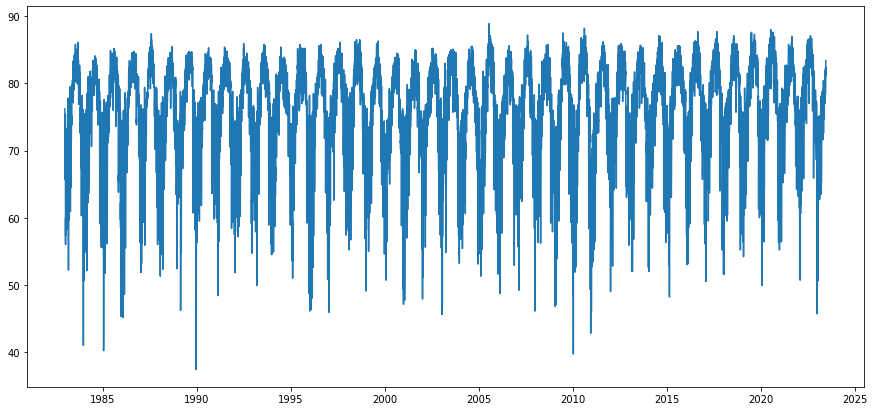

In [5]:
plt.figure(figsize = (15, 7))
plt.plot(dade_daily_avg["DATE"], dade_daily_avg["TMEAN"])
plt.show()

### Modeling

#### Finalizing dataframe to implement model

In [6]:
### selects columns
cols = ["DATE", "TMEAN"]
df = dade_daily_avg[cols]

### converts date to datetime format
df["DATE"] = pd.to_datetime(df["DATE"])

### assigns column names
df.columns = ["ds", "y"] 

### displays data
df

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3762390483.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["DATE"] = pd.to_datetime(df["DATE"])



,ds,y
0,1983-01-01,76.2
1,1983-01-02,74.3
2,1983-01-03,74.5
3,1983-01-04,73.6
4,1983-01-05,71.2
...,...,...
14770,2023-06-10,80.8
14771,2023-06-11,82.4
14772,2023-06-12,81.4
14773,2023-06-13,81.1


#### Importing model and libraries

In [7]:
### imports module
from neuralprophet import NeuralProphet
from neuralprophet import set_log_level
import logging

### imports additional date-time library
from datetime import data

#### Implementing model

In [8]:
### stores the start and end-dates for days to be forecasted
start_date = date(2023, 6, 15)
end_date = date(2054, 1, 1)

### computes number of days between them
num_days = (end_date - start_date).days

num_days

11158

In [9]:
dates = []
temps = []

n = 15

##### Defining method to compute optimal batch size

In [10]:
def find_optimal_batch_size(data):
    
    ### sets log level to only show warnings and errors
    set_log_level("ERROR")
    
    optimal_batch_size = None
    
    ### runs model for one epoch
    model = NeuralProphet(epochs = 1)
    model.fit(df, freq = "D", minimal = True, progress = None)
    
    
    ### extracts dictionary of model attributes
    paras = model.__dict__

    ### extracts and stores the training attributes
    train_paras = paras["config_train"]
    config = vars(train_paras)

    ### stores the optimal batch size
    optimal_batch_size = config["lr_finder_args"]["num_training"]
    
    return optimal_batch_size

##### Running model in parts

In [11]:
for i in range(0, 3000):
    
        print("Computing", (i+1), "of", num_days, "days:")
        
        print("Calculating batch size")
        
        ### stores length of training dataframe
        total_data_points = len(df)
        
        ### stores number of desired batches of data points to feed into the model
        if i > 0:
            desired_batches = find_optimal_batch_size(df)
        else:
            desired_batches = 254
            
        print("Desired batches —", desired_batches)
            
        ### computes and stores the number of data points in each batch
        batch_size = total_data_points // desired_batches
        remaining_data_points = total_data_points % desired_batches
        if remaining_data_points > 0:
            batch_size += 1
            
        print("Running model on dataframe")

        model = NeuralProphet(epochs = 50, daily_seasonality = True, 
                          batch_size = batch_size, n_lags = n)
        model.fit(df, freq = "D")

        ### implements model to make predictions
        future = model.make_future_dataframe(df)
        results = model.predict(future)

        ### selects columns
        results = results[["ds", "yhat1"]]

        row = []

        dates.append(results["ds"][len(results)-1])
        temps.append(results["yhat1"][len(results)-1])

        row.append([results["ds"][len(results)-1], results["yhat1"][len(results)-1]])
        add = pd.DataFrame(row, columns = ("ds", "y"))

        df = df.append(add, ignore_index = True)

WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.993% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.init_data_params) - Setting normalization to global as only one dataframe provided for training.


Computing 1 of 11158 days:
Calculating batch size
Desired batches — 254
Running model on dataframe


WARNING - (NP.config.set_lr_finder_args) - Learning rate finder: The number of batches (251) is too small than the required number for the learning rate finder (254). The results might not be optimal.


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.993% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.75% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.75% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D


Predicting: 251it [00:00, ?it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 12 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 13 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 14 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 15 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 16 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 17 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 18 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 19 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 20 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 21 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 22 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 23 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 24 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 25 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 26 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 27 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 28 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 29 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 30 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 31 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 32 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 33 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 34 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 35 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 36 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 37 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 38 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 39 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 40 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 41 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 42 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 43 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 44 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 45 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 46 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 47 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 48 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 49 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 50 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 51 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 52 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 53 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 54 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 55 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 56 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 57 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 58 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 59 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 60 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 61 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 62 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 63 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 64 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 65 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 66 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 67 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 68 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 69 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 70 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 71 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 72 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 73 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 74 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 75 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 76 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 77 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 78 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 79 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 80 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 81 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 82 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 83 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 84 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 85 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 86 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 87 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 88 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 89 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 90 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 91 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 92 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 93 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 94 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 95 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 96 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 97 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 98 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 99 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 100 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 101 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 102 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 103 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 104 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 105 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 106 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 107 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 108 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 109 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 110 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 111 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 112 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 113 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 114 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 115 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 116 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 117 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 118 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 119 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 120 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 121 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 122 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 123 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 124 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 125 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 126 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 127 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 128 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 129 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 130 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 131 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 132 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 133 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 134 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 135 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 136 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 137 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 138 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 139 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 140 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 141 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 142 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 143 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 144 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 145 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 146 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 147 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 148 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 149 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 150 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 151 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 152 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 153 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 154 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 155 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 156 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 157 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 158 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 159 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 160 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 161 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 162 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 163 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 164 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 165 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 166 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 167 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 168 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 169 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 170 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 171 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 172 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 173 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 174 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 175 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 176 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 177 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 178 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 179 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 180 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 181 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 182 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 183 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 184 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 185 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 186 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 187 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 188 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 189 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 190 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 191 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 192 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 193 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 194 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 195 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 196 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 197 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 198 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 199 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 200 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 201 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 202 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 203 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 204 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 205 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 206 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 207 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 208 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 209 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 210 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 211 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 212 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 213 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 214 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 215 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 216 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 217 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 218 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 219 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 220 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 221 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 222 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 223 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 224 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 225 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 226 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 227 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 228 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 229 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 230 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 231 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 232 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 233 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 234 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 235 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 236 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 237 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 238 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 239 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 240 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 241 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 242 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 243 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 244 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 245 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 246 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 247 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 248 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 249 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 250 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 251 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 252 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 253 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 254 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 255 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 256 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 257 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 258 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 259 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 260 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 261 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 262 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 263 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 264 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 265 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 266 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 267 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 268 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 269 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 270 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 271 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 272 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 273 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 274 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 275 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 276 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 277 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 278 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 279 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 280 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 281 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 282 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 283 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 284 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 285 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 286 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 287 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 288 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 289 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 290 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 291 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 292 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 293 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 294 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 295 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 296 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 297 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 298 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 299 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 300 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 301 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 302 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 303 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 304 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 305 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 306 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 307 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 308 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 309 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 310 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 311 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 312 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 313 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 314 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 315 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 316 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 317 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 318 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 319 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 320 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 321 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 322 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 323 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 324 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 325 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 326 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 327 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 328 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 329 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 330 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 331 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 332 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 333 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 334 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 335 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 336 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 337 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 338 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 339 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 340 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 341 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 342 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 343 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 344 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 345 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 346 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 347 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 348 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 349 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 350 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 351 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 352 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 353 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 354 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 355 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 356 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 357 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 358 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 359 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 360 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 361 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 362 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 363 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 364 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 365 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 366 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 367 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 368 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 369 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 370 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 371 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 372 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 373 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 374 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 375 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 376 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 377 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 378 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 379 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 380 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 381 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 382 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 383 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 384 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 385 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 386 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 387 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 388 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 389 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 390 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 391 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 392 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 393 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 394 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 395 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 396 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 397 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 398 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 399 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 400 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 401 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 402 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 403 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 404 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 405 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 406 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 407 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 408 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 409 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 410 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 411 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 412 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 413 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 414 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 415 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 416 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 417 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 418 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 419 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 420 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 421 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 422 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 423 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 424 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 425 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 426 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 427 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 428 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 429 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 430 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 431 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 432 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 433 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 434 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 435 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 436 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 437 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 438 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 439 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 440 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 441 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 442 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 443 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 444 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 445 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 446 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 447 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 448 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 449 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 450 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 451 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 452 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 453 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 454 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 455 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 456 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 457 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 458 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 459 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 460 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 461 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 462 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 463 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 464 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 465 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 466 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 467 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 468 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 469 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 470 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 471 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 472 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 473 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 474 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 475 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 476 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 477 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 478 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 479 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 480 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 481 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 482 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 483 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 484 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 485 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 486 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 487 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 488 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 489 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 490 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 491 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 492 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 493 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 494 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 495 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 496 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 497 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 498 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 499 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 500 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 501 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 502 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 503 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 504 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 505 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 506 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 507 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 508 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 509 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 510 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 511 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 512 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 513 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 514 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 515 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 516 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 517 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 518 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 519 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 520 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 521 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 522 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 523 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 524 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 525 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 526 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 527 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 528 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 529 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 530 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 531 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 532 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 533 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 534 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 535 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 536 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 537 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 538 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 539 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 540 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 541 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 542 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 543 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 544 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 545 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 546 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 547 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 548 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 549 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 550 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 551 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 552 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 553 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 554 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 555 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 556 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 557 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 558 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 559 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 560 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 561 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 562 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 563 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 564 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 565 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 566 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 567 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 568 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 569 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 570 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 571 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 572 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 573 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 574 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 575 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 576 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 577 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 578 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 579 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 580 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 581 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 582 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 583 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 584 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 585 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 586 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 587 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 588 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 589 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 590 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 591 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 592 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 593 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 594 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 595 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 596 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 597 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 598 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 599 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 600 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 601 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 602 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 603 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 604 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 605 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 606 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 607 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 608 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 609 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 610 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 611 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 612 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 613 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 614 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 615 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 616 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 617 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 618 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 619 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 620 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 621 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 622 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 623 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 624 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 625 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 626 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 627 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 628 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 629 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 630 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 631 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 632 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 633 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 634 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 635 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 636 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 637 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 638 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 639 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 640 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 641 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 642 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 643 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 644 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 645 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 646 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 647 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 648 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 649 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 650 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 651 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 652 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 653 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 654 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 655 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 656 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 657 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 658 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 659 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 660 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 661 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 662 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 663 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 664 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 665 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 666 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 667 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 668 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 669 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 670 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 671 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 672 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 673 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 674 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 675 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 676 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 677 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 678 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 679 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 680 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 681 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 682 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 683 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 684 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 685 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 686 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 687 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 688 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 689 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 690 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 691 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 692 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 693 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 694 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 695 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 696 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 697 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 698 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 699 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 700 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 701 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 702 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 703 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 704 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 705 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 706 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 707 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 708 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 709 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 710 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 711 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 712 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 713 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 714 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 715 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 716 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 717 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 718 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 719 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 720 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 721 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 722 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 723 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 724 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 725 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 726 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 727 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 728 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 729 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 730 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 731 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 732 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 733 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 734 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 735 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 736 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 737 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 738 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 739 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 740 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 741 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 250it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 742 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 743 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 744 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 745 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 746 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 747 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 748 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 749 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 750 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 751 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 752 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 753 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 754 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 755 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 756 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 757 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 758 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 759 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 760 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 761 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 762 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 763 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 764 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 765 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 766 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 767 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 768 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 769 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 770 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 771 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 772 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 773 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 774 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 775 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 776 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 777 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 778 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 779 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 780 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 781 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 782 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 783 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 784 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 785 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 786 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 787 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 788 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 789 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 790 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 791 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 792 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 793 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 794 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 795 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 796 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 797 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 798 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 799 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 800 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 801 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 802 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 803 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 804 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 805 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 806 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 807 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 808 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 809 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 810 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 811 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 812 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 813 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 814 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 815 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 816 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 817 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 818 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 819 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 820 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 821 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 822 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 823 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 824 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 825 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 826 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 827 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 828 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 829 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 830 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 831 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 832 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 833 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 834 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 835 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 836 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 837 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 838 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 839 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 840 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 841 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 842 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 843 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 844 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 845 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 846 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 847 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 848 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 849 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 850 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 851 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 852 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 853 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 854 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 855 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 856 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 857 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 858 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 859 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 860 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 861 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 862 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 863 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 864 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 865 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 866 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 867 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 868 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 869 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 870 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 871 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 872 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 873 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 874 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 875 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 876 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 877 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 878 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 879 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 880 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 881 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 882 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 883 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 884 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 885 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 886 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 887 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 888 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 889 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 890 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 891 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 892 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 893 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 894 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 895 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 896 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 897 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 898 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 899 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 900 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 901 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 902 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 903 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 904 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 905 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 906 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 907 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 908 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 909 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 910 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 911 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 912 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 913 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 914 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 915 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 916 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 917 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 918 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 919 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 920 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 921 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 922 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 923 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 924 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 925 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 926 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 927 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 928 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 929 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 930 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 931 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 932 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 933 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 934 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 935 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 936 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 937 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 938 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 939 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 940 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 941 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 942 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 943 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 944 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 945 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 946 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 947 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 948 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 949 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 950 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 951 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 952 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 953 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 954 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 955 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 956 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 957 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 958 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 959 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 960 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 961 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 962 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 963 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 964 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 965 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 966 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 967 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 968 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 969 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 970 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 971 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 972 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 973 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 974 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Desired batches — 254
Running model on dataframe


Finding best initial lr:   0%|          | 0/254 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 975 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 976 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 977 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 978 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 979 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 980 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 981 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 982 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 983 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 984 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 985 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 986 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 987 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 988 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 989 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 990 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 991 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 992 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 993 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 994 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 995 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 996 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 997 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 998 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 999 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1000 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1001 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1002 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1003 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1004 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1005 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1006 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1007 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1008 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1009 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1010 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1011 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1012 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1013 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1014 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1015 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1016 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1017 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1018 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1019 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1020 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1021 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1022 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1023 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1024 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1025 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1026 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1027 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1028 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1029 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1030 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1031 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1032 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1033 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1034 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1035 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1036 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1037 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1038 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1039 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1040 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1041 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1042 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1043 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1044 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1045 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1046 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1047 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1048 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1049 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1050 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1051 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1052 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1053 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1054 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1055 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1056 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1057 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1058 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1059 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1060 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1061 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1062 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1063 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1064 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1065 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1066 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1067 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1068 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1069 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1070 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1071 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1072 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1073 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1074 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1075 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1076 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1077 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1078 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1079 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1080 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1081 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1082 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1083 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1084 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1085 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1086 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1087 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1088 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1089 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1090 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1091 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1092 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1093 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1094 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1095 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1096 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1097 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1098 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1099 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1100 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1101 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1102 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1103 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1104 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1105 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1106 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1107 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1108 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1109 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1110 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1111 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1112 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1113 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1114 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1115 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1116 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1117 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1118 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1119 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1120 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1121 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1122 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1123 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1124 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1125 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1126 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1127 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1128 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1129 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1130 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1131 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1132 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1133 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1134 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1135 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1136 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1137 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1138 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1139 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1140 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1141 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1142 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1143 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1144 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1145 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1146 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1147 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1148 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1149 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1150 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1151 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1152 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1153 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1154 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1155 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1156 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1157 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1158 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1159 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1160 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1161 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1162 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1163 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1164 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1165 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1166 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1167 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1168 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1169 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1170 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1171 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1172 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1173 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1174 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1175 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1176 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1177 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1178 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1179 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1180 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1181 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1182 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1183 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1184 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1185 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1186 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1187 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1188 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1189 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1190 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1191 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1192 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1193 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1194 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1195 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1196 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1197 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1198 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1199 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1200 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1201 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1202 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1203 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1204 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1205 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1206 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1207 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1208 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1209 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1210 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1211 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1212 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1213 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1214 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1215 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1216 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1217 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1218 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1219 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1220 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1221 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1222 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1223 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1224 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1225 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1226 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1227 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1228 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1229 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1230 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1231 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1232 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1233 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1234 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1235 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1236 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1237 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1238 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1239 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1240 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1241 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1242 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1243 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1244 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1245 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1246 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1247 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1248 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1249 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1250 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1251 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1252 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1253 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1254 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1255 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1256 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1257 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1258 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1259 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1260 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1261 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1262 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1263 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1264 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1265 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1266 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1267 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1268 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1269 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1270 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1271 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1272 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1273 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1274 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1275 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1276 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1277 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1278 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1279 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1280 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1281 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1282 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1283 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1284 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1285 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1286 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1287 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1288 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1289 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1290 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1291 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1292 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1293 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1294 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1295 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1296 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1297 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1298 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1299 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1300 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1301 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1302 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1303 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1304 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1305 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1306 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1307 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1308 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1309 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1310 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1311 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1312 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1313 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1314 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1315 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1316 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1317 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1318 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1319 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1320 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1321 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1322 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1323 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1324 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1325 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1326 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1327 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1328 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1329 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1330 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1331 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1332 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1333 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1334 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1335 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1336 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1337 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1338 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1339 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1340 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1341 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1342 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1343 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1344 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1345 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1346 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1347 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1348 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1349 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1350 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1351 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1352 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1353 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1354 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1355 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1356 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1357 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1358 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1359 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1360 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1361 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1362 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1363 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1364 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1365 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1366 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1367 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1368 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1369 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1370 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1371 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1372 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1373 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1374 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1375 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1376 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1377 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1378 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1379 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1380 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1381 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1382 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1383 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1384 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1385 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1386 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1387 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1388 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1389 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1390 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1391 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1392 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1393 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1394 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1395 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1396 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1397 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1398 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1399 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1400 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1401 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1402 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1403 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1404 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1405 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1406 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1407 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1408 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1409 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1410 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1411 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1412 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1413 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1414 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1415 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1416 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1417 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1418 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1419 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1420 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1421 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1422 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1423 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1424 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1425 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1426 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1427 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1428 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1429 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1430 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1431 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1432 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1433 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1434 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1435 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1436 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1437 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1438 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1439 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1440 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1441 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1442 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1443 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1444 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1445 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1446 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1447 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1448 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1449 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1450 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1451 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1452 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1453 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1454 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1455 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1456 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1457 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1458 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1459 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1460 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1461 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1462 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1463 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1464 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1465 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1466 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1467 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1468 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1469 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1470 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1471 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1472 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1473 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1474 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1475 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1476 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1477 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1478 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1479 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1480 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1481 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1482 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1483 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1484 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1485 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1486 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1487 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1488 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1489 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1490 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1491 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1492 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1493 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1494 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1495 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1496 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1497 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1498 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1499 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1500 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1501 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1502 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1503 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1504 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1505 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1506 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1507 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1508 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1509 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1510 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1511 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1512 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1513 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1514 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1515 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1516 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1517 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1518 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1519 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1520 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1521 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1522 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1523 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1524 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1525 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1526 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1527 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1528 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1529 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1530 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1531 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1532 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1533 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1534 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1535 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1536 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1537 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1538 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1539 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1540 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1541 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1542 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1543 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1544 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1545 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1546 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1547 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1548 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1549 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1550 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1551 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1552 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1553 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1554 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1555 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1556 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1557 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1558 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1559 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1560 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1561 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1562 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1563 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1564 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1565 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1566 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1567 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1568 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1569 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1570 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1571 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1572 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1573 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1574 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1575 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1576 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1577 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1578 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1579 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1580 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1581 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1582 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1583 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1584 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1585 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1586 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1587 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1588 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1589 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1590 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1591 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1592 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1593 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1594 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1595 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1596 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1597 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1598 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1599 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1600 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1601 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1602 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1603 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1604 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1605 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1606 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1607 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1608 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1609 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1610 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1611 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1612 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1613 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1614 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1615 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1616 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1617 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1618 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1619 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1620 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1621 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1622 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1623 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1624 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1625 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1626 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1627 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1628 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1629 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1630 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1631 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1632 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1633 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1634 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1635 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1636 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1637 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1638 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1639 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1640 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1641 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1642 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1643 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1644 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1645 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1646 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1647 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1648 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1649 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1650 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1651 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1652 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1653 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1654 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1655 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1656 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1657 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1658 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1659 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1660 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1661 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1662 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1663 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1664 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1665 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1666 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1667 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1668 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1669 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1670 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1671 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1672 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1673 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1674 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1675 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1676 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1677 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1678 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1679 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1680 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1681 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1682 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1683 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1684 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1685 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1686 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1687 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1688 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1689 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1690 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1691 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1692 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1693 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1694 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1695 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1696 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1697 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1698 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1699 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1700 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1701 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1702 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1703 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1704 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1705 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1706 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1707 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1708 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1709 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1710 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1711 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1712 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1713 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1714 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1715 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1716 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1717 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1718 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1719 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1720 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1721 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1722 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1723 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1724 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1725 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1726 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1727 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1728 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1729 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1730 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1731 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1732 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1733 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1734 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1735 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1736 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1737 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1738 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1739 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1740 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1741 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1742 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1743 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1744 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1745 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1746 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1747 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1748 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1749 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1750 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1751 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1752 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1753 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1754 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1755 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1756 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1757 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1758 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1759 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1760 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1761 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1762 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1763 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1764 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1765 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1766 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1767 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1768 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1769 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1770 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1771 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1772 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1773 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1774 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1775 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1776 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1777 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1778 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1779 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1780 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1781 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1782 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1783 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1784 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1785 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1786 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1787 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1788 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1789 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1790 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1791 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1792 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1793 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1794 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1795 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1796 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1797 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1798 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1799 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1800 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1801 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1802 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1803 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1804 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1805 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1806 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1807 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1808 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1809 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1810 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1811 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1812 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1813 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1814 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1815 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1816 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1817 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1818 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1819 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1820 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1821 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1822 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1823 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1824 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1825 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1826 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1827 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1828 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1829 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1830 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1831 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1832 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1833 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1834 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1835 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1836 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1837 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1838 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1839 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1840 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1841 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1842 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1843 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1844 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1845 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1846 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1847 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1848 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1849 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1850 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1851 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1852 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1853 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1854 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1855 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1856 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1857 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1858 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1859 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1860 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1861 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1862 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1863 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1864 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1865 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1866 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1867 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1868 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1869 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1870 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1871 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1872 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1873 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1874 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1875 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1876 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1877 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1878 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1879 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1880 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1881 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1882 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1883 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1884 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1885 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1886 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1887 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1888 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1889 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1890 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1891 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1892 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1893 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1894 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1895 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1896 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1897 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1898 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1899 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1900 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1901 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1902 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1903 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1904 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1905 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1906 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1907 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1908 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1909 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1910 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1911 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1912 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1913 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1914 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1915 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1916 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1917 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1918 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1919 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1920 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1921 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1922 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1923 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1924 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1925 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1926 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1927 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1928 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1929 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1930 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1931 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1932 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1933 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1934 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1935 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1936 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1937 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1938 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1939 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1940 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1941 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1942 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1943 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1944 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1945 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1946 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1947 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1948 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1949 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1950 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1951 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1952 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1953 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1954 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1955 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1956 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1957 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1958 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1959 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1960 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1961 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1962 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1963 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1964 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1965 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1966 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1967 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1968 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1969 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1970 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1971 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1972 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1973 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1974 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1975 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1976 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1977 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1978 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1979 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1980 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1981 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1982 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1983 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1984 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1985 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1986 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1987 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1988 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1989 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1990 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1991 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1992 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1993 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1994 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1995 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1996 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1997 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1998 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 1999 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2000 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2001 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2002 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2003 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2004 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2005 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2006 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2007 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2008 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2009 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2010 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2011 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2012 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2013 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2014 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2015 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2016 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2017 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2018 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2019 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2020 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2021 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2022 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2023 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2024 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2025 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2026 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2027 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2028 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2029 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2030 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2031 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2032 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2033 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2034 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2035 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2036 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2037 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2038 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2039 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2040 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2041 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2042 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2043 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2044 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2045 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2046 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2047 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2048 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2049 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2050 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2051 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2052 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2053 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2054 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2055 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2056 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2057 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2058 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 251it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2059 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2060 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2061 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2062 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2063 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2064 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2065 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2066 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2067 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2068 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2069 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2070 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2071 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2072 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2073 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2074 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2075 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2076 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2077 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2078 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2079 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2080 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2081 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2082 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2083 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2084 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2085 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2086 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2087 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2088 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2089 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2090 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2091 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2092 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2093 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2094 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2095 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2096 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2097 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2098 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2099 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2100 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2101 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2102 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2103 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2104 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2105 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2106 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2107 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2108 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2109 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2110 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2111 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2112 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2113 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2114 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2115 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2116 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2117 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2118 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2119 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2120 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2121 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2122 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2123 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2124 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2125 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2126 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2127 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2128 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2129 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2130 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2131 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2132 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2133 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2134 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2135 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2136 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2137 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2138 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2139 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2140 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2141 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2142 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2143 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2144 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2145 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2146 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2147 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2148 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2149 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2150 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2151 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2152 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2153 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2154 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2155 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2156 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2157 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2158 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2159 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2160 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2161 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2162 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2163 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2164 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2165 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2166 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2167 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2168 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2169 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2170 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2171 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2172 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2173 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2174 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2175 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2176 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2177 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2178 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2179 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2180 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2181 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2182 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2183 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2184 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2185 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2186 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2187 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2188 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2189 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2190 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2191 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2192 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2193 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2194 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2195 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2196 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2197 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2198 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2199 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2200 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2201 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2202 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2203 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2204 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2205 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2206 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2207 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2208 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2209 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2210 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2211 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2212 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2213 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2214 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2215 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2216 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2217 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2218 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2219 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2220 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2221 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2222 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2223 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2224 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2225 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2226 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2227 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2228 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2229 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2230 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2231 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2232 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2233 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2234 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2235 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2236 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2237 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2238 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2239 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2240 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2241 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2242 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2243 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2244 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2245 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2246 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2247 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2248 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2249 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2250 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2251 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2252 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2253 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2254 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2255 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2256 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2257 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2258 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2259 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2260 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2261 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2262 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2263 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2264 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2265 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2266 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2267 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2268 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2269 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2270 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2271 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2272 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2273 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2274 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2275 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2276 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2277 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2278 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2279 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2280 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2281 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2282 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2283 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2284 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2285 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2286 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2287 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2288 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2289 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2290 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2291 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2292 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2293 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2294 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2295 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2296 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2297 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2298 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2299 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2300 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2301 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2302 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2303 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2304 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2305 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2306 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2307 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2308 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2309 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2310 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2311 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2312 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2313 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2314 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2315 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2316 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2317 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2318 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2319 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2320 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2321 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2322 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2323 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2324 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2325 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2326 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2327 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2328 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2329 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2330 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2331 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2332 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2333 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2334 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2335 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2336 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2337 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2338 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2339 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2340 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2341 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2342 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2343 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2344 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2345 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2346 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2347 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2348 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2349 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2350 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2351 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2352 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2353 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2354 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2355 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2356 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2357 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2358 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2359 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2360 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2361 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2362 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2363 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2364 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2365 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2366 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2367 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2368 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2369 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2370 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2371 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2372 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2373 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2374 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2375 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2376 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2377 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 252it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2378 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2379 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2380 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2381 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2382 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2383 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2384 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2385 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2386 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2387 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2388 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2389 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2390 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2391 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2392 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2393 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2394 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2395 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2396 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2397 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2398 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2399 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2400 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2401 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2402 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2403 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2404 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2405 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2406 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2407 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2408 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2409 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2410 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2411 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2412 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2413 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2414 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2415 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2416 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2417 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2418 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2419 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2420 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2421 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2422 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2423 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2424 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2425 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2426 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2427 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2428 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2429 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2430 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2431 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2432 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2433 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2434 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2435 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2436 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2437 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2438 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2439 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2440 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2441 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2442 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2443 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2444 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2445 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2446 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2447 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2448 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2449 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2450 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2451 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2452 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2453 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2454 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2455 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2456 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2457 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2458 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2459 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2460 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2461 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2462 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2463 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2464 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2465 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2466 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2467 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2468 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2469 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2470 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2471 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2472 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2473 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2474 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2475 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2476 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2477 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2478 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2479 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2480 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2481 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2482 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2483 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2484 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2485 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2486 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2487 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2488 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2489 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2490 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2491 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2492 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2493 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2494 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2495 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2496 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2497 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2498 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2499 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2500 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2501 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2502 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2503 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2504 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Desired batches — 255
Running model on dataframe


Finding best initial lr:   0%|          | 0/255 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2505 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2506 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2507 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2508 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2509 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2510 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2511 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2512 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2513 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2514 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2515 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2516 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2517 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2518 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2519 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2520 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2521 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2522 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2523 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2524 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2525 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2526 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2527 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2528 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2529 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2530 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2531 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2532 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2533 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2534 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2535 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2536 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2537 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2538 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2539 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2540 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2541 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2542 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2543 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2544 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2545 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2546 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2547 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2548 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2549 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2550 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2551 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2552 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2553 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2554 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2555 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2556 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2557 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2558 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2559 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2560 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2561 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2562 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2563 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2564 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2565 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2566 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2567 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2568 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2569 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2570 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2571 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2572 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2573 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2574 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2575 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2576 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2577 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2578 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2579 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2580 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2581 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2582 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2583 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2584 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2585 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2586 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2587 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2588 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2589 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2590 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2591 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2592 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2593 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2594 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2595 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2596 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2597 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2598 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2599 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2600 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2601 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2602 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2603 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2604 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2605 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2606 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2607 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2608 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2609 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2610 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2611 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2612 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2613 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2614 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2615 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2616 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2617 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2618 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2619 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2620 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2621 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2622 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2623 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2624 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2625 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2626 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2627 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2628 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2629 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2630 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2631 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2632 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2633 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2634 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2635 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2636 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2637 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2638 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2639 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2640 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2641 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2642 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2643 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2644 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2645 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2646 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2647 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2648 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2649 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2650 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2651 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2652 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2653 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2654 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2655 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2656 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2657 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2658 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2659 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2660 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2661 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2662 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2663 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2664 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2665 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2666 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2667 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2668 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2669 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2670 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2671 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2672 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2673 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2674 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2675 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2676 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2677 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2678 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2679 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2680 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2681 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2682 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2683 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2684 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2685 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2686 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2687 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2688 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2689 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2690 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2691 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2692 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2693 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2694 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2695 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2696 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2697 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2698 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2699 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2700 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2701 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2702 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2703 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2704 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2705 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2706 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2707 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2708 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2709 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2710 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2711 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2712 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2713 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2714 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2715 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2716 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2717 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2718 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2719 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2720 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2721 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2722 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2723 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2724 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2725 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2726 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2727 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2728 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2729 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2730 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2731 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2732 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2733 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2734 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2735 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2736 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2737 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2738 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2739 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2740 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2741 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2742 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2743 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2744 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2745 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2746 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2747 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2748 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2749 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2750 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2751 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2752 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2753 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2754 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2755 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2756 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2757 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2758 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2759 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2760 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2761 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2762 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2763 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2764 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2765 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2766 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2767 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2768 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2769 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2770 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2771 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2772 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2773 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2774 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2775 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2776 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2777 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2778 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2779 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2780 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2781 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2782 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2783 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2784 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2785 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2786 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2787 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2788 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2789 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2790 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2791 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2792 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2793 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2794 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2795 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2796 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2797 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2798 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2799 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2800 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2801 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2802 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2803 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2804 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2805 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2806 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2807 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2808 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2809 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2810 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2811 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2812 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2813 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2814 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2815 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2816 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2817 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2818 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2819 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2820 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2821 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2822 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2823 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2824 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2825 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2826 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2827 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2828 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2829 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2830 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2831 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2832 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2833 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2834 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2835 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2836 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2837 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2838 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2839 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2840 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2841 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2842 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2843 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2844 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2845 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2846 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2847 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2848 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2849 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2850 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2851 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2852 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2853 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2854 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2855 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2856 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2857 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2858 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2859 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2860 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2861 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2862 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2863 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2864 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2865 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2866 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2867 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2868 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2869 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2870 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2871 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2872 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2873 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2874 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2875 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2876 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2877 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2878 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2879 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2880 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2881 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2882 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2883 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2884 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2885 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2886 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2887 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2888 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2889 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2890 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2891 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2892 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2893 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2894 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2895 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2896 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2897 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2898 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2899 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2900 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2901 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2902 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2903 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2904 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2905 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2906 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2907 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2908 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2909 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2910 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2911 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2912 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2913 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2914 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2915 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2916 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2917 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2918 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2919 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2920 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2921 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2922 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2923 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2924 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2925 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2926 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2927 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2928 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2929 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2930 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2931 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2932 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2933 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2934 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2935 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2936 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2937 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2938 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2939 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2940 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2941 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2942 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2943 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2944 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2945 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2946 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2947 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2948 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2949 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2950 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2951 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2952 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2953 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2954 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2955 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2956 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2957 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2958 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2959 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2960 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2961 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2962 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2963 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2964 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2965 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2966 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2967 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2968 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2969 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2970 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2971 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2972 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2973 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2974 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2975 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2976 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2977 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2978 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2979 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2980 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2981 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2982 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2983 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2984 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2985 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2986 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2987 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2988 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2989 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2990 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2991 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2992 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2993 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2994 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2995 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2996 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2997 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2998 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 2999 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3000 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/1620985839.py:45: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



In [12]:
for i in range(3000, 6000):
    
        print("Computing", (i+1), "of", num_days, "days:")
        
        print("Calculating batch size")
    
        ### stores length of training dataframe
        total_data_points = len(df)
        
        ### stores number of desired batches of data points to feed into the model
        desired_batches = find_optimal_batch_size(df)
        
        print("Desired batches —", desired_batches)

            
        ### computes and stores the number of data points in each batch
        batch_size = total_data_points // desired_batches
        remaining_data_points = total_data_points % desired_batches
        if remaining_data_points > 0:
            batch_size += 1
            
        print("Running model on dataframe")

        model = NeuralProphet(epochs = 50, daily_seasonality = True, 
                          batch_size = batch_size, n_lags = n)
        model.fit(df, freq = "D")

        ### implements model to make predictions
        future = model.make_future_dataframe(df)
        results = model.predict(future)

        ### selects columns
        results = results[["ds", "yhat1"]]

        row = []

        dates.append(results["ds"][len(results)-1])
        temps.append(results["yhat1"][len(results)-1])

        row.append([results["ds"][len(results)-1], results["yhat1"][len(results)-1]])
        add = pd.DataFrame(row, columns = ("ds", "y"))

        df = df.append(add, ignore_index = True)

Computing 3001 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3002 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3003 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3004 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3005 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3006 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3007 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3008 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3009 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3010 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3011 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3012 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3013 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3014 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3015 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3016 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3017 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3018 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3019 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3020 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3021 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3022 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3023 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3024 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3025 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3026 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3027 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3028 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3029 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3030 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3031 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3032 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3033 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3034 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3035 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3036 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3037 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3038 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3039 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3040 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3041 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3042 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3043 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3044 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3045 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3046 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3047 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3048 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3049 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3050 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3051 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3052 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3053 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3054 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3055 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3056 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3057 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3058 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3059 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3060 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3061 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3062 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3063 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3064 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3065 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3066 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3067 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3068 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3069 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3070 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3071 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3072 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3073 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3074 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3075 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3076 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3077 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3078 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3079 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3080 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3081 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3082 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3083 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3084 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3085 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3086 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3087 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3088 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3089 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3090 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3091 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3092 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3093 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3094 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3095 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3096 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3097 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3098 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3099 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3100 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3101 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3102 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3103 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3104 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3105 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3106 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3107 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3108 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3109 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3110 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3111 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3112 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3113 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3114 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3115 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3116 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3117 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3118 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3119 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3120 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3121 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3122 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3123 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3124 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3125 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3126 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3127 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3128 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3129 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3130 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3131 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3132 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3133 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3134 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3135 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3136 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3137 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3138 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3139 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3140 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3141 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3142 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3143 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3144 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3145 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3146 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3147 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3148 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3149 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3150 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3151 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3152 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3153 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3154 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3155 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3156 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3157 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3158 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3159 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3160 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3161 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3162 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3163 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3164 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3165 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3166 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3167 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3168 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3169 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3170 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3171 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3172 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3173 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3174 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3175 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3176 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3177 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3178 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3179 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3180 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3181 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3182 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3183 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3184 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3185 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3186 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3187 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3188 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3189 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3190 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3191 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3192 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3193 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3194 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3195 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3196 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3197 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3198 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3199 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3200 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3201 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3202 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3203 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3204 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3205 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3206 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3207 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3208 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3209 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3210 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3211 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3212 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3213 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3214 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3215 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3216 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3217 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3218 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3219 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3220 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3221 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3222 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3223 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3224 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3225 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3226 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3227 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3228 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3229 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3230 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3231 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3232 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3233 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3234 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3235 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3236 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3237 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3238 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3239 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3240 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3241 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3242 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3243 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3244 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3245 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3246 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3247 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3248 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3249 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3250 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3251 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3252 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3253 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3254 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3255 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3256 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3257 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3258 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3259 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3260 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3261 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3262 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3263 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3264 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3265 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3266 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3267 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3268 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3269 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3270 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3271 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3272 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3273 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3274 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3275 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3276 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3277 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3278 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3279 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3280 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3281 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3282 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3283 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3284 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3285 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3286 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3287 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3288 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3289 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3290 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3291 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3292 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3293 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3294 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3295 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3296 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3297 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3298 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3299 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3300 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3301 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3302 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3303 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3304 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3305 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3306 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3307 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3308 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3309 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3310 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3311 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3312 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3313 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3314 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3315 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3316 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3317 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3318 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3319 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3320 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3321 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3322 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3323 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3324 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3325 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3326 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3327 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3328 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3329 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3330 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3331 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3332 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3333 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3334 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3335 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3336 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3337 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3338 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3339 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3340 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3341 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3342 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3343 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3344 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3345 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3346 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3347 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3348 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3349 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3350 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3351 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3352 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3353 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3354 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3355 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3356 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3357 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3358 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3359 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3360 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3361 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3362 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3363 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3364 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3365 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3366 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3367 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3368 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3369 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3370 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3371 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3372 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3373 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3374 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3375 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3376 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3377 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3378 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3379 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3380 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3381 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3382 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3383 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3384 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3385 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3386 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3387 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3388 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3389 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3390 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3391 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3392 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3393 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3394 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3395 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3396 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3397 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3398 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3399 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3400 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3401 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3402 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3403 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3404 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3405 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3406 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3407 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3408 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3409 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3410 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3411 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3412 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3413 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3414 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3415 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3416 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3417 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3418 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3419 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3420 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3421 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3422 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3423 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3424 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3425 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3426 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3427 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3428 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3429 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3430 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3431 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3432 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3433 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3434 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3435 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3436 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3437 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3438 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3439 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3440 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3441 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3442 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3443 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3444 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3445 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3446 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3447 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3448 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3449 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3450 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3451 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3452 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3453 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3454 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3455 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3456 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3457 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3458 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3459 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3460 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3461 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3462 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3463 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3464 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3465 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3466 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3467 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3468 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3469 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3470 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3471 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3472 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3473 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3474 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3475 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3476 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3477 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3478 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3479 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3480 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3481 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3482 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3483 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3484 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3485 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3486 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3487 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3488 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3489 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3490 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3491 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3492 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3493 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3494 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3495 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3496 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3497 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3498 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3499 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3500 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3501 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3502 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3503 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3504 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3505 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3506 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3507 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3508 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3509 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3510 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3511 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3512 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3513 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3514 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3515 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3516 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3517 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3518 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3519 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3520 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3521 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3522 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3523 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3524 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3525 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3526 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3527 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3528 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3529 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3530 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3531 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3532 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3533 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3534 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3535 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3536 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3537 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3538 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3539 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3540 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3541 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3542 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3543 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3544 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3545 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3546 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3547 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3548 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3549 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3550 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3551 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3552 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3553 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3554 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3555 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3556 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3557 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3558 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3559 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3560 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3561 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3562 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3563 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3564 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3565 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3566 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3567 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3568 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3569 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3570 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3571 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3572 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3573 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3574 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3575 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3576 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3577 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3578 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3579 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3580 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3581 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3582 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3583 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3584 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3585 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3586 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3587 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3588 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3589 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3590 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3591 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3592 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3593 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3594 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3595 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3596 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3597 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3598 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3599 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3600 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3601 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3602 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3603 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3604 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3605 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3606 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3607 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3608 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3609 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3610 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3611 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3612 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3613 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3614 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3615 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3616 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3617 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3618 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3619 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3620 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3621 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3622 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3623 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3624 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3625 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3626 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3627 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3628 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3629 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3630 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3631 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3632 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3633 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3634 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3635 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3636 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3637 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3638 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3639 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3640 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3641 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3642 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3643 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3644 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3645 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3646 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3647 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3648 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3649 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3650 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3651 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3652 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3653 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3654 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3655 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3656 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3657 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3658 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3659 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3660 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3661 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3662 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3663 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3664 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3665 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3666 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3667 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3668 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3669 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3670 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3671 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3672 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3673 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3674 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3675 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3676 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3677 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3678 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3679 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3680 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3681 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3682 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3683 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3684 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3685 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3686 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3687 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3688 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3689 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3690 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3691 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3692 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3693 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3694 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3695 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3696 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3697 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3698 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3699 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3700 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3701 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3702 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3703 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3704 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3705 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3706 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3707 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3708 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3709 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3710 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3711 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3712 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3713 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3714 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3715 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3716 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3717 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3718 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3719 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3720 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3721 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3722 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3723 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3724 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3725 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3726 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3727 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3728 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3729 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3730 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3731 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3732 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3733 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3734 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3735 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3736 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3737 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3738 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3739 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3740 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3741 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3742 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3743 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3744 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3745 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3746 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3747 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3748 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3749 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3750 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3751 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3752 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3753 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3754 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3755 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3756 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3757 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3758 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3759 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3760 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3761 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3762 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3763 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3764 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3765 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3766 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3767 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3768 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3769 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3770 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3771 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3772 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3773 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3774 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3775 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3776 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3777 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3778 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3779 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3780 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3781 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3782 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3783 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3784 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3785 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3786 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3787 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3788 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3789 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3790 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3791 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3792 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3793 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3794 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3795 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3796 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3797 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3798 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3799 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3800 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3801 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3802 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3803 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3804 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3805 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3806 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3807 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3808 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3809 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3810 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3811 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3812 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3813 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3814 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3815 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3816 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3817 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3818 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3819 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3820 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3821 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3822 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3823 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3824 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3825 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3826 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3827 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3828 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3829 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3830 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3831 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3832 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3833 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3834 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3835 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3836 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3837 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3838 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3839 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3840 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3841 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3842 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3843 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3844 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3845 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3846 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3847 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3848 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3849 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3850 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3851 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3852 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3853 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3854 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3855 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3856 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3857 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3858 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3859 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3860 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3861 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3862 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3863 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3864 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3865 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3866 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3867 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3868 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3869 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3870 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3871 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3872 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3873 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3874 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3875 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3876 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3877 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3878 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3879 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3880 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3881 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3882 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3883 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3884 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3885 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3886 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3887 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3888 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3889 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3890 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3891 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3892 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3893 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3894 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3895 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3896 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3897 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3898 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3899 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3900 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3901 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3902 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3903 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3904 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3905 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3906 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3907 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3908 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3909 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3910 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3911 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3912 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3913 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3914 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3915 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3916 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3917 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3918 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3919 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3920 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3921 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3922 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3923 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3924 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3925 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3926 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3927 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3928 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3929 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3930 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3931 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3932 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3933 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3934 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3935 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3936 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3937 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3938 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3939 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3940 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3941 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3942 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3943 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3944 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3945 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3946 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3947 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3948 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3949 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3950 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3951 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3952 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3953 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3954 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3955 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3956 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3957 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3958 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3959 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3960 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3961 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3962 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3963 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3964 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3965 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3966 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3967 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3968 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3969 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3970 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3971 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3972 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3973 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3974 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3975 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3976 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3977 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3978 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3979 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3980 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3981 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3982 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3983 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3984 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3985 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3986 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3987 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3988 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3989 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3990 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3991 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3992 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3993 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3994 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3995 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3996 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3997 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3998 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 3999 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4000 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4001 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4002 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4003 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4004 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4005 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4006 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4007 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4008 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4009 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4010 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4011 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4012 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4013 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4014 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4015 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4016 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4017 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4018 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4019 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4020 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4021 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4022 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4023 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4024 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4025 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4026 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4027 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4028 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4029 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4030 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4031 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4032 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4033 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4034 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4035 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4036 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4037 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4038 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4039 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4040 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4041 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4042 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4043 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4044 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4045 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4046 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4047 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4048 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4049 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4050 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4051 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4052 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4053 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4054 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4055 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4056 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4057 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4058 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4059 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4060 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4061 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4062 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4063 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4064 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4065 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4066 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4067 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4068 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4069 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4070 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4071 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4072 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4073 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4074 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4075 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4076 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4077 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4078 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4079 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4080 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4081 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4082 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4083 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4084 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4085 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4086 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4087 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4088 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4089 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4090 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4091 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4092 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4093 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4094 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4095 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4096 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4097 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4098 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4099 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4100 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4101 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4102 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4103 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4104 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4105 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4106 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4107 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4108 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4109 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4110 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4111 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4112 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4113 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4114 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4115 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4116 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4117 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4118 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4119 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4120 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4121 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4122 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4123 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4124 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4125 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4126 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4127 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4128 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4129 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4130 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4131 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4132 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4133 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4134 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4135 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4136 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4137 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4138 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4139 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4140 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4141 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4142 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4143 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4144 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4145 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4146 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4147 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4148 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4149 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4150 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4151 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4152 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4153 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4154 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4155 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4156 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4157 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4158 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4159 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4160 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4161 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4162 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4163 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4164 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4165 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4166 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4167 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4168 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4169 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4170 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4171 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4172 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4173 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4174 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4175 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4176 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4177 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4178 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4179 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4180 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Desired batches — 256
Running model on dataframe


Finding best initial lr:   0%|          | 0/256 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 253it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4181 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4182 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4183 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4184 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4185 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4186 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4187 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4188 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4189 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4190 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4191 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4192 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4193 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4194 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4195 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4196 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4197 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4198 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4199 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4200 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4201 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4202 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4203 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4204 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4205 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4206 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4207 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4208 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4209 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4210 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4211 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4212 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4213 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4214 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4215 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4216 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4217 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4218 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4219 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4220 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4221 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4222 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4223 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4224 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4225 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4226 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4227 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4228 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4229 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4230 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4231 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4232 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4233 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4234 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4235 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4236 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4237 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4238 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4239 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4240 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4241 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4242 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4243 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4244 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4245 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4246 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4247 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4248 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4249 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4250 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4251 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4252 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4253 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4254 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4255 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4256 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4257 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4258 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4259 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4260 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4261 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4262 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4263 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4264 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4265 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4266 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4267 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4268 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4269 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4270 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4271 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4272 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4273 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4274 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4275 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4276 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4277 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4278 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4279 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4280 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4281 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4282 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4283 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4284 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4285 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4286 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4287 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4288 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4289 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4290 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4291 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4292 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4293 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4294 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4295 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4296 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4297 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4298 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4299 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4300 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4301 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4302 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4303 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4304 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4305 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4306 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4307 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4308 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4309 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4310 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4311 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4312 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4313 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4314 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4315 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4316 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4317 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4318 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4319 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4320 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4321 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4322 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4323 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4324 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4325 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4326 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4327 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4328 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4329 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4330 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4331 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4332 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4333 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4334 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4335 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4336 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4337 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4338 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4339 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4340 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4341 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4342 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4343 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4344 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4345 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4346 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4347 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4348 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4349 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4350 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4351 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4352 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4353 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4354 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4355 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4356 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4357 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4358 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4359 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4360 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4361 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4362 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4363 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4364 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4365 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4366 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4367 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4368 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4369 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4370 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4371 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4372 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4373 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4374 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4375 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4376 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4377 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4378 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4379 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4380 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4381 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4382 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4383 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4384 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4385 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4386 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4387 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4388 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4389 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4390 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4391 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4392 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4393 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4394 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4395 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4396 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4397 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4398 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4399 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4400 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4401 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4402 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4403 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4404 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4405 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4406 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4407 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4408 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4409 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4410 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4411 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4412 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4413 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4414 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4415 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4416 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4417 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4418 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4419 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4420 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4421 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4422 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4423 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4424 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4425 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4426 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4427 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4428 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4429 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4430 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4431 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4432 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4433 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4434 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4435 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4436 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4437 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4438 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4439 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4440 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4441 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4442 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4443 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4444 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4445 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4446 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4447 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4448 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4449 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4450 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4451 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4452 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4453 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4454 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4455 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4456 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4457 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4458 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4459 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4460 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4461 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4462 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4463 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4464 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4465 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4466 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4467 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4468 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4469 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4470 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4471 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4472 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4473 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4474 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4475 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4476 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4477 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4478 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4479 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4480 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4481 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4482 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4483 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4484 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4485 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4486 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4487 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4488 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4489 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4490 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4491 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4492 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4493 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4494 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4495 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4496 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4497 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4498 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4499 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4500 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4501 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4502 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4503 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4504 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4505 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4506 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4507 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4508 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4509 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4510 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4511 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4512 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4513 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4514 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4515 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4516 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4517 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4518 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4519 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4520 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4521 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4522 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4523 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4524 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4525 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4526 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4527 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4528 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4529 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4530 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4531 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4532 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4533 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4534 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4535 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4536 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4537 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4538 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4539 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4540 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4541 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4542 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4543 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4544 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4545 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4546 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4547 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4548 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4549 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4550 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4551 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4552 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4553 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4554 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4555 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4556 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4557 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4558 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4559 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4560 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4561 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4562 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4563 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4564 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4565 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4566 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4567 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4568 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4569 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4570 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4571 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4572 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4573 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4574 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4575 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4576 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4577 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4578 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4579 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4580 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4581 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4582 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4583 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4584 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4585 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4586 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4587 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4588 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4589 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4590 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4591 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4592 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4593 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4594 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4595 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4596 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4597 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4598 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4599 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4600 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4601 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4602 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4603 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4604 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4605 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4606 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4607 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4608 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4609 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4610 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4611 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4612 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4613 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4614 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4615 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4616 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4617 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4618 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4619 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4620 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4621 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4622 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4623 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4624 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4625 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4626 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4627 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4628 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4629 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4630 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4631 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4632 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4633 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4634 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4635 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4636 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4637 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4638 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4639 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4640 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4641 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4642 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4643 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4644 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4645 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4646 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4647 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4648 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4649 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4650 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4651 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4652 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4653 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4654 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4655 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4656 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4657 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4658 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4659 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4660 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4661 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4662 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4663 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4664 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4665 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4666 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4667 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4668 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4669 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4670 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4671 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4672 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4673 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4674 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4675 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4676 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4677 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4678 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4679 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4680 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4681 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4682 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4683 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4684 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4685 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4686 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4687 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4688 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4689 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4690 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4691 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4692 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4693 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4694 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4695 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4696 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4697 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4698 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4699 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4700 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4701 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4702 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4703 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4704 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4705 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4706 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4707 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4708 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4709 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4710 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4711 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4712 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4713 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4714 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4715 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4716 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4717 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4718 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4719 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4720 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4721 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4722 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4723 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4724 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4725 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4726 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4727 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4728 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4729 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4730 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4731 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4732 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4733 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4734 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4735 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4736 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4737 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4738 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4739 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4740 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4741 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4742 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4743 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4744 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4745 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4746 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4747 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4748 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4749 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4750 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4751 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4752 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4753 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4754 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4755 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4756 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4757 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4758 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4759 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4760 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4761 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4762 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4763 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4764 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4765 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4766 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4767 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4768 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4769 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4770 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4771 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4772 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4773 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4774 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4775 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4776 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4777 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4778 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4779 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4780 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4781 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4782 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4783 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4784 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4785 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4786 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4787 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4788 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4789 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4790 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4791 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4792 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4793 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4794 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4795 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4796 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4797 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4798 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4799 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4800 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4801 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4802 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4803 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4804 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4805 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4806 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4807 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4808 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4809 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4810 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4811 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4812 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4813 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4814 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4815 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4816 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4817 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4818 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4819 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4820 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4821 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4822 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4823 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4824 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4825 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4826 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4827 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4828 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4829 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4830 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4831 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4832 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4833 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4834 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4835 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4836 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4837 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4838 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4839 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4840 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4841 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4842 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4843 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4844 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4845 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4846 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4847 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4848 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4849 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4850 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4851 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4852 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4853 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4854 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4855 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4856 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4857 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4858 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4859 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4860 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4861 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4862 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4863 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4864 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4865 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4866 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4867 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4868 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4869 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4870 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4871 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4872 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4873 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4874 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4875 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4876 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4877 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4878 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4879 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4880 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4881 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4882 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4883 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4884 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4885 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4886 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4887 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4888 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4889 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4890 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4891 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4892 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4893 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4894 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4895 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4896 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4897 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4898 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4899 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4900 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4901 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4902 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4903 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4904 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4905 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4906 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4907 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4908 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4909 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4910 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4911 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4912 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4913 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4914 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4915 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4916 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4917 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4918 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4919 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4920 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4921 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4922 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4923 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4924 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4925 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4926 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4927 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4928 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4929 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4930 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4931 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4932 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4933 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4934 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4935 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4936 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4937 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4938 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4939 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4940 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4941 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4942 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4943 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4944 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4945 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4946 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4947 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4948 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4949 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4950 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4951 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4952 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4953 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4954 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4955 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4956 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4957 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4958 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4959 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4960 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4961 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4962 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4963 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4964 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4965 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4966 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4967 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4968 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4969 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4970 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4971 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4972 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4973 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4974 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4975 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4976 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4977 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4978 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4979 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4980 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4981 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4982 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4983 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4984 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4985 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4986 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4987 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4988 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4989 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4990 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4991 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4992 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4993 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4994 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4995 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4996 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4997 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4998 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 4999 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5000 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5001 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5002 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5003 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5004 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5005 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5006 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5007 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5008 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5009 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5010 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5011 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5012 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5013 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5014 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5015 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5016 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5017 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5018 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5019 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5020 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5021 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5022 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5023 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5024 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5025 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5026 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5027 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5028 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5029 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5030 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5031 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5032 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5033 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5034 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5035 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5036 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5037 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5038 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5039 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5040 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5041 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5042 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5043 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5044 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5045 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5046 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5047 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5048 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5049 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5050 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5051 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5052 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5053 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5054 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5055 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5056 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5057 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5058 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5059 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5060 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5061 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5062 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5063 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5064 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5065 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5066 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5067 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5068 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5069 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5070 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5071 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5072 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5073 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5074 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5075 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5076 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5077 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5078 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5079 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5080 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5081 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5082 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5083 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5084 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5085 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5086 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5087 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5088 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5089 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5090 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5091 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5092 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5093 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5094 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5095 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5096 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5097 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5098 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5099 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5100 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5101 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5102 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5103 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5104 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5105 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5106 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5107 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5108 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5109 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5110 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5111 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5112 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5113 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5114 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5115 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5116 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5117 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5118 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5119 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5120 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5121 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5122 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5123 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5124 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5125 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5126 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5127 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5128 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5129 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5130 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5131 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5132 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5133 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5134 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5135 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5136 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5137 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5138 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5139 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5140 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5141 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5142 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5143 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5144 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5145 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5146 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5147 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5148 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5149 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5150 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5151 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5152 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5153 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5154 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5155 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5156 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5157 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5158 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5159 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5160 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5161 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5162 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5163 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5164 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5165 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5166 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5167 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5168 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5169 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5170 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5171 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5172 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5173 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5174 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5175 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5176 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5177 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5178 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5179 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5180 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5181 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5182 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5183 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5184 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5185 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5186 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5187 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5188 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5189 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5190 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5191 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5192 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5193 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5194 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5195 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5196 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5197 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5198 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5199 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5200 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5201 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5202 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5203 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5204 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5205 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5206 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5207 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5208 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5209 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5210 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5211 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5212 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5213 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5214 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5215 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5216 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5217 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5218 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5219 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5220 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5221 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5222 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5223 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5224 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5225 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5226 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5227 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5228 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5229 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5230 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5231 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5232 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5233 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5234 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5235 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5236 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5237 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5238 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5239 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5240 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5241 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5242 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5243 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5244 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5245 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5246 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5247 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5248 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5249 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5250 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5251 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5252 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5253 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5254 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5255 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5256 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5257 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5258 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5259 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5260 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5261 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5262 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5263 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5264 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5265 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5266 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5267 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5268 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5269 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5270 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5271 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5272 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5273 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5274 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5275 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5276 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5277 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5278 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5279 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5280 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5281 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5282 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5283 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5284 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5285 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5286 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5287 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5288 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5289 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5290 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5291 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5292 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5293 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5294 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5295 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5296 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5297 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5298 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5299 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5300 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5301 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5302 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5303 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5304 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5305 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5306 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5307 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5308 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5309 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5310 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5311 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5312 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5313 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5314 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5315 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5316 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5317 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5318 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5319 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5320 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5321 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5322 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5323 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5324 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5325 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5326 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5327 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5328 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5329 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5330 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5331 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5332 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5333 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5334 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5335 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5336 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5337 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5338 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5339 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5340 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5341 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5342 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5343 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5344 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5345 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5346 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5347 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5348 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5349 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5350 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5351 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5352 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5353 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5354 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5355 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5356 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5357 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5358 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5359 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5360 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5361 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5362 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5363 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5364 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5365 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5366 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5367 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5368 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5369 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5370 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5371 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5372 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5373 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5374 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5375 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5376 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5377 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5378 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5379 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5380 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5381 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5382 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5383 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5384 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5385 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5386 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5387 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5388 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5389 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5390 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5391 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5392 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5393 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5394 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5395 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5396 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5397 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5398 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5399 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5400 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5401 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5402 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5403 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5404 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5405 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5406 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5407 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5408 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5409 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5410 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5411 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5412 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5413 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5414 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5415 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5416 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5417 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5418 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5419 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5420 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5421 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5422 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5423 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5424 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5425 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5426 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5427 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5428 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5429 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5430 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5431 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5432 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5433 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5434 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5435 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5436 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5437 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5438 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5439 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5440 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5441 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5442 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5443 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5444 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5445 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5446 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5447 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5448 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5449 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5450 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5451 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5452 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5453 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5454 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5455 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5456 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5457 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5458 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5459 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5460 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5461 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5462 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5463 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5464 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5465 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5466 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5467 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5468 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5469 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5470 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5471 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5472 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5473 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5474 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5475 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5476 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5477 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5478 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5479 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5480 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5481 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5482 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5483 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5484 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5485 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5486 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5487 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5488 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5489 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5490 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5491 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5492 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5493 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5494 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5495 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5496 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5497 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5498 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5499 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5500 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5501 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5502 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5503 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5504 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5505 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5506 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5507 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5508 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5509 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5510 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5511 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5512 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5513 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5514 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5515 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5516 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5517 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5518 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5519 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5520 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5521 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5522 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5523 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5524 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5525 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5526 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5527 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5528 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5529 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5530 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5531 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5532 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5533 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5534 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5535 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5536 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5537 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5538 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5539 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5540 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5541 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5542 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5543 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5544 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5545 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5546 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5547 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5548 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5549 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5550 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5551 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5552 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5553 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5554 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5555 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5556 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5557 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5558 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5559 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5560 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5561 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5562 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5563 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5564 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5565 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5566 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5567 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5568 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5569 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5570 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5571 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5572 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5573 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5574 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5575 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5576 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5577 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5578 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5579 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5580 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5581 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5582 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5583 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5584 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5585 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5586 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5587 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5588 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5589 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5590 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5591 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5592 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5593 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5594 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5595 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5596 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5597 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5598 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5599 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5600 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5601 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5602 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5603 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5604 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5605 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5606 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5607 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5608 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5609 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5610 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5611 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5612 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5613 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5614 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5615 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5616 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5617 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5618 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5619 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5620 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5621 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5622 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5623 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5624 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5625 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5626 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5627 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5628 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5629 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5630 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5631 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5632 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5633 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5634 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5635 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5636 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5637 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5638 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5639 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5640 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5641 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5642 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5643 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5644 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5645 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5646 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5647 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5648 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5649 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5650 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5651 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5652 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5653 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5654 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5655 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5656 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5657 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5658 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5659 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5660 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5661 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5662 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5663 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5664 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5665 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5666 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5667 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5668 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5669 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5670 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5671 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5672 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5673 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5674 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5675 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5676 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5677 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5678 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5679 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5680 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5681 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5682 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5683 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5684 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5685 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5686 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5687 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5688 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5689 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5690 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5691 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5692 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5693 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5694 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5695 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5696 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5697 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5698 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5699 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5700 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5701 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5702 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5703 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5704 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5705 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5706 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5707 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5708 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5709 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5710 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5711 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5712 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5713 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5714 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5715 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5716 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5717 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5718 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5719 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5720 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5721 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5722 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5723 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5724 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5725 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5726 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5727 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5728 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5729 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5730 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5731 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5732 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5733 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5734 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5735 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5736 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5737 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5738 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5739 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5740 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5741 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5742 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5743 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5744 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5745 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5746 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5747 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5748 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5749 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5750 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5751 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5752 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5753 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5754 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5755 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5756 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5757 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5758 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5759 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5760 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5761 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5762 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5763 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5764 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5765 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5766 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5767 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5768 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5769 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5770 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5771 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5772 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5773 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5774 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5775 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5776 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5777 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5778 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5779 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5780 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5781 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5782 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5783 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5784 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5785 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5786 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5787 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5788 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5789 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5790 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5791 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5792 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5793 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5794 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5795 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5796 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5797 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5798 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5799 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5800 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5801 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5802 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5803 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5804 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5805 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5806 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5807 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5808 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5809 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5810 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5811 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5812 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5813 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5814 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5815 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 254it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5816 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5817 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5818 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5819 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5820 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5821 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5822 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5823 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5824 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5825 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5826 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5827 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5828 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5829 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5830 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5831 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5832 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5833 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5834 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5835 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5836 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5837 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5838 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5839 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5840 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5841 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5842 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5843 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5844 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5845 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5846 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5847 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5848 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5849 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5850 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5851 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5852 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5853 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5854 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5855 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5856 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5857 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5858 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5859 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5860 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5861 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5862 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5863 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5864 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5865 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5866 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5867 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5868 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5869 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5870 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5871 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5872 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5873 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5874 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5875 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5876 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5877 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5878 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5879 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5880 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5881 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5882 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5883 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5884 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5885 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5886 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5887 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5888 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5889 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5890 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5891 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5892 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5893 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5894 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5895 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5896 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5897 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5898 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5899 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5900 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5901 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5902 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5903 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5904 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5905 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5906 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5907 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5908 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5909 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5910 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5911 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5912 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5913 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5914 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5915 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5916 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5917 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5918 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5919 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5920 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5921 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5922 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5923 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5924 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5925 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5926 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5927 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5928 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5929 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5930 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5931 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5932 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5933 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5934 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5935 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5936 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5937 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5938 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5939 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5940 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5941 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5942 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5943 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5944 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5945 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5946 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5947 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5948 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5949 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5950 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5951 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5952 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5953 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5954 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5955 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5956 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5957 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5958 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5959 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5960 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5961 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5962 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5963 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5964 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5965 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5966 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5967 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5968 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5969 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5970 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5971 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5972 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5973 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5974 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5975 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5976 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5977 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5978 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5979 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5980 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5981 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5982 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5983 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5984 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5985 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5986 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5987 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5988 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5989 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5990 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5991 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5992 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5993 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5994 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5995 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5996 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5997 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5998 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 5999 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6000 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/2348515497.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



In [13]:
for i in range(6000, 9000):
    
        print("Computing", (i+1), "of", num_days, "days:")
        
        print("Calculating batch size")
    
        ### stores length of training dataframe
        total_data_points = len(df)
        
        ### stores number of desired batches of data points to feed into the model
        desired_batches = find_optimal_batch_size(df)
        
        print("Desired batches —", desired_batches)
            
        ### computes and stores the number of data points in each batch
        batch_size = total_data_points // desired_batches
        remaining_data_points = total_data_points % desired_batches
        if remaining_data_points > 0:
            batch_size += 1

        print("Running model on dataframe")
        
        model = NeuralProphet(epochs = 50, daily_seasonality = True, 
                          batch_size = batch_size, n_lags = n)
        model.fit(df, freq = "D")

        ### implements model to make predictions
        future = model.make_future_dataframe(df)
        results = model.predict(future)

        ### selects columns
        results = results[["ds", "yhat1"]]

        row = []

        dates.append(results["ds"][len(results)-1])
        temps.append(results["yhat1"][len(results)-1])

        row.append([results["ds"][len(results)-1], results["yhat1"][len(results)-1]])
        add = pd.DataFrame(row, columns = ("ds", "y"))

        df = df.append(add, ignore_index = True)

Computing 6001 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6002 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6003 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6004 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6005 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6006 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6007 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6008 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6009 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6010 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6011 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6012 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6013 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6014 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6015 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6016 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6017 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6018 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Desired batches — 257
Running model on dataframe


Finding best initial lr:   0%|          | 0/257 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6019 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6020 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6021 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6022 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6023 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6024 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6025 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6026 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6027 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6028 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6029 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6030 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6031 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6032 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6033 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6034 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6035 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6036 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6037 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6038 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6039 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6040 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6041 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6042 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6043 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6044 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6045 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6046 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6047 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6048 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6049 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6050 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6051 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6052 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6053 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6054 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6055 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6056 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6057 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6058 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6059 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6060 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6061 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6062 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6063 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6064 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6065 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6066 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6067 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6068 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6069 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6070 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6071 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6072 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6073 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6074 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6075 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6076 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6077 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6078 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6079 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6080 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6081 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6082 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6083 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6084 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6085 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6086 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6087 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6088 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6089 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6090 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6091 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6092 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6093 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6094 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6095 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6096 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6097 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6098 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6099 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6100 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6101 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6102 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6103 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6104 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6105 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6106 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6107 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6108 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6109 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6110 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6111 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6112 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6113 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6114 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6115 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6116 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6117 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6118 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6119 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6120 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6121 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6122 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6123 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6124 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6125 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6126 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6127 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6128 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6129 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6130 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6131 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6132 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6133 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6134 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6135 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6136 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6137 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6138 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6139 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6140 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6141 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6142 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6143 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6144 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6145 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6146 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6147 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6148 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6149 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6150 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6151 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6152 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6153 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6154 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6155 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6156 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6157 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6158 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6159 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6160 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6161 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6162 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6163 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6164 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6165 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6166 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6167 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6168 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6169 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6170 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6171 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6172 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6173 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6174 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6175 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6176 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6177 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6178 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6179 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6180 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6181 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6182 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6183 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6184 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6185 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6186 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6187 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6188 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6189 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6190 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6191 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6192 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6193 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6194 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6195 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6196 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6197 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6198 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6199 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6200 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6201 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6202 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6203 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6204 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6205 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6206 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6207 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6208 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6209 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6210 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6211 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6212 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6213 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6214 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6215 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6216 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6217 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6218 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6219 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6220 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6221 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6222 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6223 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6224 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6225 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6226 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6227 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6228 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6229 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6230 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6231 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6232 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6233 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6234 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6235 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6236 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6237 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6238 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6239 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6240 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6241 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6242 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6243 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6244 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6245 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6246 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6247 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6248 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6249 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6250 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6251 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6252 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6253 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6254 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6255 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6256 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6257 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6258 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6259 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6260 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6261 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6262 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6263 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6264 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6265 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6266 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6267 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6268 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6269 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6270 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6271 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6272 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6273 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6274 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6275 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6276 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6277 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6278 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6279 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6280 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6281 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6282 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6283 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6284 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6285 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6286 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6287 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6288 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6289 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6290 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6291 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6292 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6293 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6294 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6295 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6296 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6297 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6298 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6299 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6300 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6301 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6302 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6303 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6304 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6305 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6306 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6307 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6308 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6309 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6310 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6311 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6312 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6313 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6314 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6315 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6316 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6317 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6318 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6319 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6320 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6321 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6322 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6323 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6324 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6325 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6326 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6327 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6328 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6329 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6330 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6331 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6332 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6333 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6334 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6335 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6336 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6337 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6338 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6339 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6340 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6341 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6342 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6343 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6344 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6345 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6346 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6347 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6348 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6349 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6350 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6351 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6352 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6353 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6354 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6355 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6356 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6357 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6358 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6359 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6360 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6361 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6362 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6363 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6364 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6365 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6366 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6367 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6368 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6369 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6370 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6371 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6372 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6373 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6374 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6375 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6376 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6377 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6378 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6379 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6380 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6381 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6382 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6383 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6384 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6385 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6386 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6387 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6388 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6389 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6390 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6391 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6392 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6393 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6394 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6395 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6396 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6397 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6398 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6399 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6400 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6401 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6402 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6403 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6404 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6405 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6406 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6407 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6408 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6409 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6410 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6411 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6412 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6413 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6414 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6415 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6416 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6417 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6418 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6419 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6420 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6421 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6422 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6423 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6424 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6425 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6426 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6427 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6428 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6429 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6430 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6431 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6432 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6433 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6434 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6435 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6436 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6437 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6438 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6439 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6440 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6441 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6442 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6443 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6444 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6445 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6446 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6447 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6448 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6449 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6450 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6451 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6452 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6453 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6454 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6455 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6456 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6457 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6458 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6459 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6460 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6461 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6462 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6463 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6464 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6465 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6466 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6467 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6468 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6469 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6470 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6471 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6472 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6473 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6474 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6475 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6476 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6477 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6478 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6479 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6480 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6481 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6482 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6483 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6484 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6485 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6486 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6487 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6488 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6489 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6490 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6491 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6492 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6493 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6494 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6495 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6496 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6497 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6498 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6499 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6500 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6501 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6502 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6503 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6504 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6505 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6506 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6507 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6508 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6509 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6510 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6511 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6512 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6513 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6514 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6515 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6516 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6517 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6518 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6519 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6520 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6521 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6522 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6523 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6524 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6525 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6526 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6527 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6528 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6529 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6530 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6531 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6532 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6533 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6534 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6535 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6536 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6537 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6538 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6539 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6540 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6541 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6542 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6543 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6544 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6545 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6546 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6547 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6548 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6549 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6550 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6551 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6552 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6553 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6554 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6555 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6556 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6557 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6558 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6559 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6560 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6561 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6562 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6563 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6564 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6565 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6566 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6567 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6568 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6569 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6570 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6571 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6572 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6573 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6574 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6575 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6576 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6577 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6578 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6579 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6580 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6581 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6582 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6583 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6584 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6585 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6586 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6587 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6588 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6589 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6590 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6591 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6592 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6593 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6594 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6595 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6596 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6597 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6598 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6599 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6600 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6601 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6602 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6603 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6604 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6605 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6606 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6607 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6608 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6609 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6610 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6611 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6612 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6613 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6614 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6615 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6616 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6617 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6618 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6619 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6620 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6621 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6622 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6623 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6624 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6625 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6626 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6627 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6628 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6629 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6630 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6631 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6632 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6633 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6634 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6635 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6636 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6637 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6638 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6639 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6640 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6641 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6642 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6643 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6644 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6645 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6646 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6647 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6648 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6649 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6650 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6651 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6652 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6653 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6654 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6655 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6656 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6657 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6658 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6659 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6660 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6661 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6662 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6663 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6664 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6665 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6666 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6667 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6668 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6669 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6670 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6671 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6672 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6673 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6674 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6675 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6676 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6677 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6678 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6679 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6680 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6681 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6682 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6683 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6684 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6685 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6686 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6687 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6688 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6689 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6690 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6691 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6692 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6693 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6694 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6695 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6696 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6697 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6698 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6699 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6700 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6701 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6702 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6703 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6704 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6705 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6706 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6707 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6708 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6709 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6710 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6711 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6712 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6713 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6714 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6715 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6716 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6717 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6718 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6719 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6720 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6721 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6722 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6723 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6724 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6725 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6726 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6727 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6728 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6729 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6730 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6731 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6732 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6733 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6734 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6735 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6736 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6737 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6738 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6739 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6740 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6741 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6742 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6743 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6744 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6745 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6746 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6747 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6748 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6749 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6750 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6751 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6752 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6753 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6754 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6755 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6756 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6757 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6758 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6759 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6760 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6761 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6762 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6763 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6764 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6765 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6766 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6767 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6768 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6769 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6770 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6771 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6772 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6773 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6774 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6775 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6776 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6777 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6778 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6779 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6780 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6781 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6782 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6783 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6784 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6785 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6786 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6787 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6788 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6789 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6790 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6791 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6792 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6793 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6794 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6795 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6796 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6797 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6798 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6799 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6800 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6801 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6802 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6803 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6804 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6805 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6806 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6807 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6808 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6809 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6810 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6811 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6812 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6813 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6814 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6815 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6816 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6817 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6818 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6819 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6820 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6821 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6822 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6823 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6824 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6825 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6826 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6827 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6828 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6829 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6830 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6831 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6832 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6833 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6834 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6835 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6836 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6837 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6838 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6839 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6840 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6841 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6842 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6843 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6844 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6845 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6846 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6847 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6848 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6849 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6850 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6851 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6852 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6853 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6854 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6855 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6856 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6857 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6858 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6859 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6860 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6861 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6862 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6863 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6864 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6865 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6866 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6867 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6868 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6869 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6870 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6871 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6872 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6873 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6874 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6875 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6876 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6877 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6878 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6879 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6880 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6881 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6882 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6883 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6884 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6885 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6886 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6887 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6888 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6889 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6890 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6891 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6892 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6893 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6894 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6895 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6896 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6897 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6898 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6899 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6900 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6901 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6902 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6903 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6904 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6905 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6906 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6907 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6908 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6909 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6910 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6911 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6912 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6913 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6914 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6915 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6916 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6917 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6918 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6919 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6920 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6921 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6922 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6923 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6924 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6925 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6926 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6927 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6928 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6929 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6930 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6931 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6932 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6933 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6934 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6935 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6936 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6937 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6938 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6939 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6940 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6941 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6942 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6943 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6944 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6945 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6946 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6947 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6948 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6949 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6950 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6951 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6952 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6953 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6954 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6955 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6956 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6957 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6958 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6959 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6960 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6961 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6962 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6963 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6964 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6965 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6966 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6967 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6968 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6969 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6970 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6971 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6972 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6973 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6974 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6975 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6976 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6977 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6978 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6979 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6980 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6981 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6982 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6983 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6984 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6985 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6986 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6987 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6988 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6989 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6990 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6991 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6992 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6993 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6994 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6995 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6996 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6997 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6998 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 6999 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7000 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7001 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7002 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7003 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7004 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7005 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7006 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7007 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7008 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7009 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7010 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7011 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7012 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7013 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7014 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7015 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7016 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7017 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7018 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7019 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7020 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7021 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7022 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7023 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7024 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7025 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7026 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7027 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7028 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7029 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7030 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7031 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7032 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7033 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7034 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7035 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7036 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7037 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7038 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7039 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7040 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7041 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7042 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7043 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7044 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7045 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7046 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7047 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7048 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7049 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7050 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7051 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7052 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7053 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7054 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7055 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7056 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7057 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7058 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7059 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7060 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7061 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7062 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7063 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7064 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7065 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7066 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7067 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7068 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7069 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7070 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7071 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7072 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7073 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7074 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7075 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7076 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7077 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7078 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7079 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7080 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7081 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7082 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7083 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7084 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7085 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7086 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7087 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7088 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7089 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7090 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7091 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7092 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7093 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7094 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7095 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7096 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7097 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7098 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7099 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7100 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7101 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7102 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7103 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7104 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7105 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7106 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7107 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7108 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7109 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7110 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7111 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7112 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7113 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7114 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7115 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7116 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7117 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7118 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7119 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7120 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7121 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7122 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7123 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7124 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7125 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7126 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7127 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7128 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7129 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7130 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7131 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7132 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7133 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7134 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7135 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7136 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7137 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7138 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7139 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7140 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7141 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7142 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7143 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7144 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7145 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7146 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7147 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7148 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7149 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7150 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7151 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7152 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7153 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7154 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7155 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7156 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7157 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7158 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7159 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7160 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7161 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7162 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7163 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7164 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7165 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7166 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7167 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7168 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7169 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7170 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7171 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7172 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7173 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7174 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7175 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7176 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7177 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7178 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7179 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7180 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7181 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7182 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7183 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7184 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7185 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7186 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7187 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7188 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7189 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7190 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7191 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7192 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7193 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7194 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7195 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7196 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7197 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7198 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7199 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7200 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7201 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7202 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7203 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7204 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7205 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7206 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7207 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7208 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7209 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7210 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7211 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7212 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7213 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7214 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7215 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7216 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7217 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7218 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7219 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7220 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7221 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7222 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7223 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7224 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7225 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7226 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7227 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7228 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7229 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7230 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7231 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7232 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7233 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7234 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7235 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7236 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7237 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7238 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7239 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7240 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7241 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7242 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7243 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7244 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7245 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7246 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7247 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7248 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7249 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7250 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7251 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7252 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7253 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7254 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7255 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7256 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7257 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7258 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7259 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7260 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7261 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7262 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7263 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7264 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7265 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7266 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7267 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7268 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7269 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7270 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7271 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7272 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7273 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7274 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7275 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7276 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7277 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7278 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7279 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7280 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7281 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7282 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7283 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7284 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7285 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7286 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7287 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7288 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7289 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7290 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7291 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7292 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7293 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7294 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7295 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7296 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7297 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7298 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7299 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7300 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7301 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7302 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7303 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7304 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7305 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7306 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7307 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7308 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7309 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7310 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7311 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7312 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7313 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7314 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7315 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7316 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7317 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7318 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7319 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7320 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7321 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7322 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7323 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7324 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7325 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7326 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7327 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7328 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7329 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7330 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7331 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7332 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7333 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7334 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7335 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7336 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7337 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7338 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7339 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7340 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7341 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7342 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7343 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7344 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7345 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7346 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7347 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7348 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7349 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7350 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7351 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7352 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7353 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7354 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7355 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7356 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7357 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7358 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7359 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7360 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7361 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7362 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7363 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7364 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7365 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7366 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7367 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7368 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7369 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7370 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7371 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7372 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7373 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7374 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7375 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7376 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7377 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7378 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7379 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7380 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7381 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7382 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7383 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7384 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7385 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7386 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7387 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7388 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7389 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7390 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7391 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7392 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7393 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7394 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7395 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7396 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7397 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7398 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7399 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7400 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7401 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7402 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7403 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7404 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7405 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7406 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7407 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7408 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7409 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7410 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7411 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7412 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7413 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7414 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7415 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7416 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7417 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7418 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7419 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7420 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7421 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7422 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7423 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7424 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7425 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7426 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7427 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7428 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7429 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7430 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7431 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7432 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7433 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7434 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7435 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7436 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7437 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7438 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7439 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7440 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7441 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7442 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7443 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7444 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7445 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7446 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7447 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7448 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7449 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7450 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7451 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7452 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7453 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7454 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7455 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7456 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7457 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7458 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7459 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7460 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7461 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7462 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7463 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7464 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7465 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7466 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7467 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7468 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7469 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7470 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7471 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7472 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7473 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7474 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7475 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7476 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7477 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7478 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7479 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7480 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7481 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7482 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7483 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7484 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7485 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7486 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7487 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7488 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7489 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7490 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7491 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7492 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7493 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7494 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7495 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7496 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7497 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7498 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7499 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7500 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7501 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7502 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7503 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7504 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7505 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7506 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7507 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7508 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7509 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7510 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7511 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7512 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7513 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7514 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7515 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7516 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7517 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7518 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7519 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7520 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7521 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7522 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7523 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7524 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7525 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7526 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7527 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7528 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7529 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7530 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7531 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7532 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7533 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7534 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7535 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7536 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7537 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7538 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7539 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7540 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7541 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7542 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7543 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7544 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7545 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7546 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7547 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7548 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7549 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7550 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7551 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7552 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7553 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7554 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7555 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7556 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7557 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7558 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7559 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7560 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7561 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7562 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7563 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7564 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7565 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7566 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7567 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7568 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7569 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7570 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7571 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7572 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7573 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7574 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7575 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7576 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7577 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7578 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7579 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7580 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7581 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7582 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7583 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7584 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7585 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7586 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7587 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7588 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7589 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7590 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7591 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7592 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7593 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7594 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7595 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7596 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7597 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7598 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7599 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7600 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7601 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7602 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7603 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7604 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7605 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7606 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7607 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7608 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7609 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7610 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7611 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7612 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7613 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7614 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7615 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7616 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7617 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7618 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7619 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7620 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7621 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7622 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7623 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7624 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7625 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7626 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7627 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7628 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7629 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7630 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7631 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7632 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7633 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7634 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7635 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7636 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7637 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7638 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7639 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7640 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7641 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7642 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7643 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7644 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7645 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7646 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7647 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7648 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7649 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7650 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7651 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7652 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7653 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7654 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7655 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7656 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7657 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7658 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7659 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7660 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7661 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7662 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7663 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7664 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7665 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7666 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7667 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7668 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7669 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7670 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7671 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7672 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7673 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7674 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7675 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7676 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7677 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7678 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7679 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7680 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7681 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7682 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7683 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7684 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7685 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7686 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7687 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7688 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7689 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7690 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7691 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7692 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7693 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7694 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7695 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7696 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7697 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7698 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7699 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7700 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7701 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7702 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7703 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7704 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7705 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7706 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7707 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7708 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7709 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7710 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7711 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7712 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7713 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7714 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7715 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7716 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7717 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7718 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7719 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7720 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7721 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7722 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7723 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7724 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7725 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7726 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7727 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7728 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7729 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7730 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7731 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7732 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7733 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7734 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7735 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7736 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7737 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7738 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7739 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7740 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7741 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7742 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7743 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7744 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7745 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7746 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7747 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7748 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7749 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7750 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7751 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7752 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7753 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7754 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7755 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7756 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7757 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7758 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7759 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7760 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7761 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7762 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7763 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7764 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7765 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7766 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7767 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7768 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7769 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7770 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7771 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7772 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7773 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7774 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7775 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7776 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7777 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7778 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7779 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7780 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7781 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7782 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7783 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7784 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7785 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7786 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7787 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7788 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7789 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7790 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7791 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7792 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7793 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7794 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7795 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7796 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7797 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7798 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7799 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7800 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7801 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7802 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7803 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7804 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7805 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7806 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7807 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7808 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7809 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7810 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7811 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7812 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7813 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7814 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7815 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7816 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7817 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7818 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7819 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7820 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7821 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7822 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7823 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7824 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7825 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7826 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7827 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7828 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7829 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7830 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7831 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7832 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7833 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7834 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7835 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7836 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7837 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7838 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7839 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7840 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7841 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7842 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7843 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7844 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7845 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7846 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7847 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7848 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7849 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7850 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7851 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7852 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7853 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7854 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7855 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7856 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7857 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7858 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7859 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7860 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7861 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7862 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7863 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7864 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7865 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7866 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7867 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7868 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7869 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7870 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7871 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7872 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7873 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7874 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7875 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7876 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7877 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7878 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7879 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7880 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7881 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7882 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7883 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7884 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7885 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7886 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7887 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7888 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7889 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7890 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7891 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7892 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7893 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7894 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7895 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7896 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7897 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7898 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7899 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7900 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7901 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7902 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7903 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7904 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7905 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7906 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7907 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7908 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7909 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7910 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7911 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7912 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7913 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7914 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7915 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7916 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7917 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7918 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7919 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7920 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7921 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7922 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7923 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7924 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7925 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7926 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7927 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7928 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7929 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7930 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7931 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7932 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7933 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7934 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7935 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7936 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 255it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7937 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7938 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7939 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7940 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7941 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7942 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7943 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7944 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7945 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7946 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7947 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7948 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7949 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7950 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7951 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7952 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7953 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7954 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7955 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7956 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7957 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7958 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7959 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7960 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7961 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7962 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7963 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7964 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7965 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7966 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7967 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7968 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7969 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7970 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7971 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7972 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7973 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7974 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7975 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7976 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7977 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7978 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7979 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7980 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7981 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7982 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7983 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7984 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7985 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7986 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7987 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7988 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7989 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7990 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7991 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7992 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7993 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7994 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7995 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7996 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7997 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7998 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 7999 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8000 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8001 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8002 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8003 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8004 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8005 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8006 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8007 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8008 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8009 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8010 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8011 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8012 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8013 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8014 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8015 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8016 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8017 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8018 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8019 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8020 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8021 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8022 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8023 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8024 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8025 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8026 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8027 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8028 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8029 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8030 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8031 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8032 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8033 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8034 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Desired batches — 258
Running model on dataframe


Finding best initial lr:   0%|          | 0/258 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8035 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8036 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8037 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8038 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8039 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8040 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8041 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8042 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8043 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8044 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8045 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8046 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8047 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8048 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8049 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8050 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8051 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8052 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8053 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8054 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8055 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8056 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8057 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8058 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8059 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8060 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8061 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8062 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8063 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8064 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8065 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8066 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8067 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8068 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8069 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8070 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8071 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8072 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8073 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8074 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8075 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8076 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8077 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8078 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8079 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8080 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8081 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8082 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8083 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8084 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8085 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8086 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8087 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8088 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8089 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8090 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8091 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8092 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8093 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8094 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8095 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8096 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8097 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8098 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8099 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8100 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8101 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8102 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8103 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8104 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8105 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8106 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8107 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8108 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8109 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8110 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8111 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8112 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8113 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8114 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8115 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8116 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8117 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8118 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8119 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8120 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8121 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8122 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8123 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8124 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8125 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8126 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8127 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8128 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8129 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8130 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8131 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8132 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8133 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8134 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8135 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8136 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8137 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8138 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8139 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8140 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8141 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8142 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8143 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8144 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8145 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8146 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8147 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8148 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8149 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8150 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8151 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8152 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8153 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8154 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8155 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8156 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8157 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8158 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8159 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8160 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8161 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8162 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8163 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8164 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8165 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8166 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8167 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8168 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8169 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8170 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8171 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8172 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8173 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8174 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8175 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8176 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8177 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8178 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8179 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8180 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8181 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8182 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8183 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8184 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8185 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8186 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8187 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8188 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8189 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8190 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8191 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8192 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8193 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8194 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8195 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8196 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8197 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8198 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8199 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8200 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8201 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8202 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8203 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8204 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8205 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8206 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8207 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8208 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8209 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8210 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8211 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8212 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8213 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8214 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8215 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8216 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8217 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8218 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8219 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8220 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8221 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8222 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8223 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8224 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8225 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8226 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8227 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8228 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8229 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8230 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8231 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8232 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8233 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8234 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8235 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8236 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8237 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8238 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8239 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8240 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8241 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8242 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8243 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8244 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8245 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8246 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8247 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8248 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8249 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8250 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8251 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8252 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8253 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8254 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8255 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8256 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8257 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8258 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8259 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8260 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8261 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8262 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8263 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8264 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8265 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8266 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8267 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8268 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8269 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8270 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8271 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8272 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8273 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8274 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8275 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8276 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8277 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8278 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8279 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8280 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8281 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8282 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8283 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8284 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8285 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8286 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8287 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8288 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8289 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8290 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8291 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8292 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8293 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8294 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8295 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8296 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8297 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8298 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8299 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8300 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8301 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8302 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8303 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8304 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8305 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8306 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8307 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8308 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8309 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8310 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8311 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8312 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8313 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8314 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8315 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8316 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8317 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8318 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8319 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8320 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8321 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8322 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8323 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8324 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8325 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8326 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8327 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8328 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8329 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8330 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8331 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8332 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8333 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8334 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8335 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8336 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8337 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8338 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8339 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8340 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8341 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8342 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8343 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8344 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8345 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8346 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8347 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8348 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8349 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8350 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8351 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8352 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8353 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8354 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8355 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8356 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8357 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8358 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8359 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8360 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8361 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8362 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8363 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8364 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8365 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8366 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8367 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8368 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8369 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8370 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8371 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8372 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8373 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8374 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8375 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8376 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8377 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8378 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8379 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8380 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8381 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8382 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8383 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8384 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8385 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8386 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8387 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8388 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8389 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8390 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8391 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8392 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8393 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8394 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8395 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8396 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8397 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8398 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8399 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8400 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8401 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8402 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8403 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8404 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8405 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8406 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8407 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8408 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8409 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8410 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8411 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8412 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8413 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8414 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8415 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8416 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8417 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8418 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8419 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8420 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8421 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8422 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8423 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8424 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8425 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8426 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8427 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8428 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8429 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8430 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8431 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8432 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8433 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8434 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8435 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8436 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8437 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8438 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8439 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8440 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8441 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8442 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8443 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8444 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8445 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8446 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8447 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8448 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8449 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8450 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8451 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8452 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8453 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8454 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8455 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8456 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8457 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8458 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8459 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8460 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8461 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8462 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8463 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8464 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8465 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8466 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8467 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8468 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8469 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8470 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8471 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8472 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8473 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8474 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8475 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8476 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8477 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8478 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8479 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8480 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8481 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8482 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8483 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8484 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8485 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8486 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8487 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8488 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8489 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8490 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8491 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8492 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8493 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8494 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8495 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8496 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8497 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8498 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8499 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8500 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8501 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8502 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8503 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8504 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8505 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8506 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8507 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8508 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8509 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8510 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8511 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8512 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8513 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8514 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8515 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8516 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8517 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8518 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8519 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8520 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8521 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8522 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8523 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8524 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8525 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8526 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8527 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8528 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8529 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8530 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8531 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8532 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8533 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8534 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8535 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8536 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8537 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 256it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8538 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8539 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8540 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8541 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8542 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8543 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8544 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8545 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8546 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8547 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8548 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8549 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8550 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8551 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8552 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8553 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8554 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8555 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8556 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8557 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8558 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8559 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8560 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8561 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8562 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8563 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8564 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8565 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8566 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8567 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8568 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8569 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8570 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8571 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8572 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8573 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8574 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8575 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8576 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8577 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8578 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8579 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8580 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8581 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8582 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8583 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8584 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8585 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8586 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8587 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8588 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8589 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8590 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8591 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8592 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8593 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8594 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8595 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8596 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8597 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8598 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8599 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8600 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8601 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8602 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8603 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8604 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8605 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8606 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8607 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8608 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8609 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8610 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8611 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8612 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8613 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8614 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8615 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8616 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8617 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8618 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8619 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8620 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8621 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8622 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8623 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8624 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8625 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8626 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8627 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8628 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8629 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8630 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8631 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8632 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8633 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8634 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8635 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8636 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8637 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8638 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8639 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8640 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8641 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8642 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8643 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8644 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8645 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8646 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8647 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8648 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8649 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8650 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8651 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8652 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8653 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8654 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8655 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8656 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8657 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8658 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8659 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8660 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8661 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8662 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8663 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8664 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8665 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8666 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8667 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8668 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8669 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8670 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8671 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8672 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8673 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8674 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8675 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8676 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8677 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8678 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8679 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8680 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8681 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8682 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8683 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8684 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8685 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8686 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8687 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8688 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8689 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8690 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8691 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8692 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8693 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8694 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8695 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8696 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8697 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8698 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8699 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8700 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8701 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8702 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8703 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8704 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8705 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8706 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8707 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8708 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8709 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8710 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8711 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8712 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8713 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8714 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8715 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8716 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8717 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8718 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8719 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8720 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8721 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8722 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8723 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8724 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8725 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8726 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8727 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8728 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8729 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8730 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8731 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8732 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8733 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8734 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8735 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8736 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8737 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8738 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8739 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8740 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8741 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8742 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8743 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8744 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8745 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8746 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8747 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8748 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8749 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8750 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8751 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8752 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8753 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8754 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8755 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8756 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8757 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8758 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8759 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8760 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8761 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8762 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8763 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8764 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8765 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8766 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8767 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8768 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8769 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8770 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8771 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8772 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8773 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8774 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8775 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8776 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8777 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8778 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8779 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8780 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8781 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8782 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8783 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8784 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8785 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8786 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8787 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8788 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8789 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8790 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8791 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8792 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8793 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8794 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8795 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8796 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8797 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8798 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8799 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8800 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8801 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8802 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8803 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8804 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8805 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8806 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8807 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8808 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8809 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8810 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8811 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8812 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8813 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8814 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8815 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8816 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8817 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8818 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8819 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8820 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8821 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8822 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8823 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8824 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8825 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8826 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8827 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8828 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8829 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8830 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8831 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8832 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8833 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8834 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8835 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8836 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8837 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8838 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8839 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8840 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8841 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8842 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8843 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8844 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8845 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8846 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8847 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8848 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8849 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8850 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8851 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8852 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8853 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8854 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8855 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8856 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8857 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8858 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8859 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8860 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8861 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8862 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8863 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8864 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8865 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8866 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8867 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8868 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8869 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8870 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8871 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8872 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8873 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8874 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8875 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8876 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8877 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8878 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8879 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8880 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8881 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8882 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8883 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8884 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8885 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8886 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8887 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8888 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8889 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8890 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8891 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8892 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8893 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8894 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8895 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8896 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8897 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8898 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8899 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8900 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8901 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8902 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8903 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8904 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8905 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8906 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8907 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8908 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8909 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8910 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8911 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8912 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8913 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8914 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8915 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8916 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8917 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8918 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8919 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8920 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8921 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8922 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8923 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8924 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8925 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8926 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8927 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8928 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8929 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8930 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8931 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8932 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8933 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8934 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8935 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8936 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8937 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8938 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8939 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8940 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8941 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8942 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8943 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8944 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8945 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8946 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8947 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8948 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8949 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8950 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8951 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8952 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8953 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8954 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8955 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8956 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8957 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8958 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8959 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8960 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8961 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8962 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8963 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8964 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8965 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8966 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8967 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8968 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8969 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8970 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8971 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8972 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8973 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8974 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8975 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8976 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8977 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8978 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8979 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8980 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8981 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8982 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8983 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8984 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8985 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8986 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8987 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8988 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8989 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8990 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8991 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8992 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8993 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8994 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8995 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8996 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8997 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8998 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 8999 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9000 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/441469009.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



In [14]:
for i in range(9000, num_days):
    
        print("Computing", (i+1), "of", num_days, "days:")
        
        print("Calculating batch size")
    
        ### stores length of training dataframe
        total_data_points = len(df)
        
        ### stores number of desired batches of data points to feed into the model
        desired_batches = find_optimal_batch_size(df)
        
        print("Desired batches —", desired_batches)
            
        ### computes and stores the number of data points in each batch
        batch_size = total_data_points // desired_batches
        remaining_data_points = total_data_points % desired_batches
        if remaining_data_points > 0:
            batch_size += 1
            
        print("Running model on dataframe")

        model = NeuralProphet(epochs = 50, daily_seasonality = True, 
                          batch_size = batch_size, n_lags = n)
        model.fit(df, freq = "D")

        ### implements model to make predictions
        future = model.make_future_dataframe(df)
        results = model.predict(future)

        ### selects columns
        results = results[["ds", "yhat1"]]

        row = []

        dates.append(results["ds"][len(results)-1])
        temps.append(results["yhat1"][len(results)-1])

        row.append([results["ds"][len(results)-1], results["yhat1"][len(results)-1]])
        add = pd.DataFrame(row, columns = ("ds", "y"))

        df = df.append(add, ignore_index = True)

Computing 9001 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9002 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9003 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9004 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9005 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9006 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9007 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9008 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9009 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9010 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9011 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9012 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9013 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9014 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9015 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9016 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9017 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9018 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9019 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9020 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9021 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9022 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9023 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9024 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9025 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9026 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9027 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9028 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9029 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9030 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9031 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9032 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9033 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9034 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9035 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9036 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9037 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9038 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9039 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9040 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9041 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9042 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9043 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9044 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9045 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9046 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9047 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9048 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9049 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9050 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9051 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9052 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9053 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9054 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9055 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9056 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9057 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9058 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9059 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9060 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9061 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9062 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9063 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9064 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9065 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9066 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9067 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9068 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9069 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9070 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9071 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9072 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9073 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9074 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9075 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9076 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9077 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9078 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9079 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9080 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9081 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9082 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9083 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9084 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9085 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9086 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9087 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9088 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9089 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9090 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9091 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9092 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9093 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9094 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9095 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9096 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9097 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9098 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9099 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9100 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9101 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9102 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9103 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9104 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9105 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9106 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9107 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9108 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9109 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9110 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9111 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9112 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9113 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9114 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9115 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9116 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9117 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9118 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9119 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9120 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9121 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9122 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9123 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9124 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9125 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9126 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9127 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9128 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9129 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9130 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9131 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9132 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9133 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9134 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9135 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9136 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9137 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9138 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9139 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9140 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9141 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9142 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9143 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9144 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9145 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9146 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9147 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9148 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9149 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9150 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9151 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9152 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9153 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9154 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9155 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9156 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9157 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9158 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9159 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9160 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9161 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9162 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9163 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9164 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9165 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9166 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9167 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9168 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9169 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9170 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9171 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9172 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9173 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9174 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9175 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9176 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9177 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9178 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9179 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9180 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9181 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9182 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9183 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9184 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9185 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9186 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9187 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9188 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9189 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9190 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9191 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9192 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9193 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9194 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9195 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9196 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9197 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9198 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9199 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9200 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9201 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9202 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9203 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9204 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9205 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9206 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9207 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9208 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9209 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9210 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9211 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9212 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9213 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9214 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9215 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9216 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9217 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9218 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9219 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9220 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9221 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9222 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9223 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9224 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9225 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9226 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9227 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9228 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9229 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9230 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9231 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9232 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9233 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9234 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9235 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9236 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9237 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9238 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9239 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9240 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9241 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9242 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9243 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9244 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9245 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9246 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9247 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9248 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9249 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9250 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9251 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9252 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9253 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9254 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9255 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9256 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9257 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9258 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9259 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9260 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9261 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9262 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9263 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9264 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9265 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9266 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9267 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9268 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9269 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9270 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9271 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9272 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9273 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9274 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9275 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9276 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9277 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9278 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9279 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9280 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9281 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9282 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9283 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9284 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9285 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9286 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9287 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9288 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9289 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9290 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9291 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9292 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9293 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9294 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9295 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9296 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9297 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9298 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9299 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9300 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9301 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9302 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9303 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9304 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9305 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9306 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9307 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9308 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9309 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9310 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9311 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9312 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9313 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9314 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9315 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9316 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9317 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9318 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9319 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9320 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9321 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9322 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9323 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9324 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9325 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9326 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9327 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9328 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9329 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9330 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9331 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9332 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9333 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9334 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9335 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9336 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9337 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9338 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9339 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9340 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9341 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9342 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9343 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9344 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9345 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9346 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9347 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9348 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9349 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9350 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9351 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9352 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9353 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9354 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9355 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9356 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9357 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9358 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9359 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9360 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9361 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9362 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9363 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9364 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9365 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9366 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9367 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9368 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9369 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9370 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9371 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9372 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9373 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9374 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9375 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9376 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9377 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9378 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9379 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9380 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9381 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9382 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9383 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9384 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9385 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9386 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9387 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9388 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9389 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9390 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9391 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9392 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9393 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9394 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9395 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9396 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9397 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9398 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9399 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9400 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9401 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9402 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9403 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9404 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9405 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9406 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9407 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9408 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9409 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9410 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9411 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9412 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9413 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9414 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9415 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9416 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9417 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9418 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9419 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9420 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9421 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9422 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9423 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9424 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9425 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9426 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9427 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9428 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9429 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9430 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9431 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9432 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9433 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9434 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9435 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9436 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9437 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9438 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9439 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9440 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9441 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9442 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9443 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9444 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9445 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9446 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9447 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9448 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9449 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9450 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9451 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9452 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9453 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9454 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9455 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9456 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9457 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9458 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9459 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9460 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9461 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9462 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9463 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9464 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9465 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9466 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9467 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9468 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9469 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9470 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9471 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9472 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9473 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9474 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9475 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9476 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9477 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9478 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9479 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9480 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9481 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9482 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9483 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9484 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9485 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9486 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9487 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9488 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9489 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9490 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9491 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9492 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9493 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9494 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9495 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9496 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9497 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9498 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9499 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9500 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9501 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9502 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9503 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9504 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9505 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9506 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9507 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9508 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9509 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9510 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9511 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9512 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9513 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9514 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9515 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9516 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9517 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9518 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9519 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9520 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9521 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9522 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9523 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9524 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9525 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9526 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9527 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9528 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9529 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9530 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9531 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9532 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9533 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9534 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9535 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9536 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9537 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9538 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9539 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9540 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9541 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9542 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9543 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9544 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9545 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9546 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9547 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9548 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9549 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9550 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9551 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9552 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9553 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9554 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9555 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9556 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9557 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9558 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9559 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9560 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9561 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9562 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9563 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9564 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9565 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9566 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9567 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9568 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9569 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9570 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9571 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9572 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9573 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9574 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9575 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9576 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9577 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9578 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9579 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9580 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9581 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9582 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9583 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9584 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9585 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9586 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9587 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9588 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9589 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9590 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9591 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9592 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9593 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9594 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9595 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9596 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9597 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9598 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9599 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9600 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9601 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9602 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9603 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9604 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9605 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9606 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9607 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9608 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9609 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9610 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9611 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9612 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9613 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9614 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9615 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9616 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9617 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9618 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9619 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9620 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9621 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9622 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9623 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9624 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9625 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9626 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9627 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9628 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9629 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9630 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9631 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9632 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9633 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9634 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9635 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9636 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9637 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9638 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9639 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9640 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9641 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9642 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9643 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9644 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9645 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9646 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9647 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9648 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9649 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9650 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9651 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9652 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9653 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9654 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9655 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9656 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9657 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9658 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9659 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9660 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9661 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9662 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9663 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9664 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9665 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9666 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9667 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9668 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9669 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9670 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9671 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9672 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9673 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9674 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9675 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9676 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9677 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9678 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9679 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9680 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9681 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9682 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9683 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9684 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9685 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9686 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9687 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9688 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9689 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9690 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9691 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9692 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9693 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9694 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9695 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9696 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9697 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9698 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9699 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9700 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9701 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9702 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9703 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9704 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9705 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9706 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9707 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9708 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9709 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9710 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9711 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9712 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9713 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9714 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9715 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9716 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9717 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9718 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9719 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9720 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9721 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9722 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9723 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9724 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9725 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9726 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9727 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9728 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9729 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9730 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9731 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9732 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9733 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9734 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9735 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9736 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9737 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9738 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9739 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9740 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9741 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9742 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9743 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9744 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9745 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9746 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9747 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9748 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9749 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9750 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9751 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9752 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9753 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9754 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9755 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9756 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9757 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9758 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9759 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9760 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9761 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9762 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9763 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9764 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9765 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9766 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9767 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9768 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9769 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9770 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9771 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9772 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9773 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9774 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9775 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9776 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9777 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9778 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9779 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9780 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9781 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9782 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9783 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9784 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9785 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9786 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9787 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9788 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9789 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9790 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9791 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9792 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9793 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9794 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9795 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9796 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9797 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9798 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9799 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9800 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9801 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9802 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9803 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9804 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9805 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9806 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9807 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9808 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9809 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9810 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9811 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9812 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9813 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9814 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9815 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9816 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9817 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9818 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9819 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9820 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9821 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9822 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9823 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9824 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9825 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9826 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9827 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9828 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9829 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9830 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9831 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9832 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9833 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9834 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9835 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9836 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9837 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9838 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9839 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9840 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9841 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9842 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9843 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9844 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9845 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9846 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9847 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9848 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9849 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9850 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9851 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9852 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9853 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9854 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9855 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9856 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9857 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9858 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9859 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9860 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9861 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9862 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9863 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9864 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9865 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9866 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9867 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9868 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9869 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9870 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9871 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9872 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9873 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9874 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9875 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9876 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9877 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9878 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9879 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9880 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9881 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9882 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9883 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9884 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9885 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9886 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9887 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9888 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9889 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9890 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9891 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9892 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9893 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9894 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9895 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9896 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9897 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9898 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9899 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9900 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9901 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9902 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9903 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9904 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9905 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9906 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9907 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9908 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9909 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9910 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9911 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9912 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9913 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9914 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9915 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9916 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9917 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9918 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9919 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9920 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9921 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9922 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9923 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9924 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9925 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9926 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9927 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9928 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9929 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9930 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9931 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9932 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9933 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9934 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9935 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9936 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9937 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9938 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9939 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9940 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9941 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9942 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9943 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9944 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9945 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9946 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9947 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9948 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9949 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9950 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9951 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9952 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9953 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9954 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9955 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9956 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9957 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9958 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9959 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9960 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9961 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9962 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9963 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9964 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9965 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9966 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9967 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9968 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9969 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9970 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9971 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9972 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9973 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9974 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9975 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9976 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9977 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9978 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9979 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9980 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9981 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9982 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9983 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9984 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9985 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9986 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9987 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9988 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9989 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9990 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9991 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9992 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9993 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9994 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9995 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9996 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9997 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9998 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 9999 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10000 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10001 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10002 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10003 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10004 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10005 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10006 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10007 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10008 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10009 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10010 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10011 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10012 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10013 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10014 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10015 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10016 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10017 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10018 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10019 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10020 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10021 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10022 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10023 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10024 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10025 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10026 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10027 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10028 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10029 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10030 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10031 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10032 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10033 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10034 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10035 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10036 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10037 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10038 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10039 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10040 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10041 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10042 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10043 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10044 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10045 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10046 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10047 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10048 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10049 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10050 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10051 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10052 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10053 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10054 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10055 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10056 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10057 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10058 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10059 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10060 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10061 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10062 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10063 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10064 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10065 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10066 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10067 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10068 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10069 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10070 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10071 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10072 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10073 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10074 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10075 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10076 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10077 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10078 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10079 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10080 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10081 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10082 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10083 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10084 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10085 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10086 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10087 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10088 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10089 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10090 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10091 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10092 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10093 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10094 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10095 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10096 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10097 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10098 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10099 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10100 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10101 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10102 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10103 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10104 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10105 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10106 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10107 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10108 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10109 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10110 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10111 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10112 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10113 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10114 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10115 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10116 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10117 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10118 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10119 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10120 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10121 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10122 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10123 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10124 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10125 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10126 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10127 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10128 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10129 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10130 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10131 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10132 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10133 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10134 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10135 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10136 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10137 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10138 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10139 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10140 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10141 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10142 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10143 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10144 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10145 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10146 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10147 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10148 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10149 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10150 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10151 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10152 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10153 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10154 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10155 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10156 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10157 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10158 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10159 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10160 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10161 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10162 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10163 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10164 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10165 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10166 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10167 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10168 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10169 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10170 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 257it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10171 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10172 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10173 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10174 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10175 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10176 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10177 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10178 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10179 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10180 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10181 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10182 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10183 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10184 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10185 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10186 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10187 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10188 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10189 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10190 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10191 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10192 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10193 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10194 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10195 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10196 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10197 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10198 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10199 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10200 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10201 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10202 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10203 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10204 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10205 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10206 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10207 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10208 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10209 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10210 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10211 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10212 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10213 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10214 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10215 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10216 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10217 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10218 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10219 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10220 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10221 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10222 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10223 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10224 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10225 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10226 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10227 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10228 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10229 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10230 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10231 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10232 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10233 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10234 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10235 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10236 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10237 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10238 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10239 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10240 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10241 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10242 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10243 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10244 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Desired batches — 259
Running model on dataframe


Finding best initial lr:   0%|          | 0/259 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10245 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10246 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10247 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10248 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10249 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10250 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10251 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10252 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10253 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10254 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10255 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10256 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10257 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10258 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10259 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10260 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10261 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10262 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10263 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10264 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10265 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10266 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10267 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10268 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10269 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10270 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10271 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10272 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10273 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10274 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10275 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10276 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10277 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10278 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10279 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10280 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10281 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10282 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10283 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10284 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10285 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10286 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10287 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10288 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10289 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10290 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10291 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10292 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10293 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10294 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10295 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10296 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10297 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10298 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10299 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10300 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10301 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10302 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10303 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10304 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10305 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10306 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10307 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10308 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10309 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10310 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10311 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10312 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10313 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10314 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10315 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10316 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10317 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10318 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10319 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10320 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10321 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10322 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10323 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10324 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10325 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10326 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10327 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10328 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10329 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10330 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10331 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10332 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10333 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10334 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10335 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10336 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10337 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10338 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10339 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10340 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10341 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10342 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10343 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10344 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10345 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10346 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10347 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10348 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10349 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10350 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10351 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10352 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10353 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10354 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10355 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10356 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10357 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10358 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10359 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10360 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10361 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10362 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10363 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10364 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10365 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10366 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10367 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10368 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10369 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10370 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10371 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10372 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10373 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10374 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10375 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10376 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10377 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10378 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10379 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10380 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10381 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10382 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10383 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10384 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10385 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10386 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10387 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10388 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10389 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10390 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10391 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10392 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10393 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10394 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10395 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10396 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10397 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10398 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10399 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10400 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10401 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10402 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10403 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10404 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10405 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10406 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10407 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10408 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10409 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10410 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10411 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10412 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10413 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10414 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10415 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10416 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10417 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10418 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10419 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10420 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10421 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10422 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10423 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10424 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10425 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10426 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10427 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10428 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10429 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10430 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10431 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10432 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10433 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10434 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10435 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10436 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10437 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10438 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10439 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10440 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10441 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10442 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10443 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10444 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10445 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10446 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10447 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10448 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10449 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10450 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10451 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10452 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10453 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10454 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10455 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10456 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10457 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10458 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10459 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10460 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10461 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10462 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10463 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10464 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10465 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10466 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10467 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10468 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10469 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10470 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10471 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10472 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10473 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10474 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10475 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10476 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10477 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10478 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10479 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10480 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10481 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10482 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10483 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10484 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10485 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10486 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10487 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10488 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10489 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10490 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10491 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10492 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10493 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10494 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10495 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10496 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10497 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10498 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10499 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10500 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10501 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10502 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10503 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10504 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10505 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10506 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10507 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10508 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10509 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10510 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10511 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10512 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10513 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10514 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10515 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10516 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10517 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10518 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10519 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10520 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10521 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10522 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10523 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10524 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10525 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10526 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10527 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10528 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10529 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10530 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10531 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10532 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10533 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10534 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10535 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10536 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10537 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10538 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10539 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10540 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10541 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10542 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10543 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10544 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10545 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10546 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10547 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10548 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10549 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10550 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10551 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10552 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10553 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10554 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10555 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10556 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10557 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10558 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10559 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10560 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10561 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10562 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10563 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10564 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10565 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10566 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10567 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10568 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10569 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10570 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10571 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10572 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10573 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10574 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10575 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10576 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10577 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10578 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10579 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10580 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10581 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10582 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10583 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10584 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10585 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10586 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10587 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10588 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10589 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10590 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10591 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10592 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10593 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10594 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10595 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10596 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10597 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10598 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10599 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10600 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10601 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10602 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10603 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10604 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10605 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10606 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10607 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10608 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10609 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10610 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10611 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10612 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10613 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10614 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10615 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10616 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10617 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10618 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10619 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10620 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10621 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10622 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10623 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10624 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10625 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10626 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10627 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10628 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10629 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10630 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10631 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10632 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10633 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10634 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10635 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10636 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10637 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10638 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10639 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10640 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10641 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10642 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10643 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10644 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10645 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10646 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10647 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10648 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10649 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10650 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10651 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10652 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10653 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10654 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10655 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10656 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10657 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10658 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10659 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10660 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10661 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10662 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10663 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10664 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10665 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10666 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10667 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10668 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10669 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10670 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10671 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10672 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10673 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10674 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10675 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10676 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10677 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10678 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10679 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10680 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10681 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10682 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10683 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10684 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10685 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10686 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10687 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10688 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10689 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10690 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10691 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10692 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10693 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10694 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10695 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10696 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10697 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10698 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10699 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10700 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10701 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10702 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10703 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10704 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10705 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10706 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10707 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10708 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10709 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10710 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10711 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10712 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10713 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10714 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10715 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10716 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10717 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10718 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10719 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10720 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10721 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10722 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10723 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10724 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10725 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10726 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10727 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10728 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10729 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10730 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10731 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10732 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10733 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10734 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10735 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10736 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10737 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10738 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10739 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10740 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10741 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10742 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10743 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10744 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10745 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10746 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10747 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10748 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10749 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10750 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10751 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10752 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10753 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10754 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10755 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10756 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10757 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10758 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10759 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10760 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10761 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10762 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10763 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10764 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10765 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10766 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10767 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10768 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10769 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10770 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10771 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10772 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10773 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10774 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10775 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10776 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10777 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10778 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10779 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10780 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10781 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10782 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10783 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10784 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10785 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10786 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10787 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10788 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10789 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10790 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10791 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10792 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10793 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10794 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10795 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10796 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10797 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10798 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10799 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10800 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10801 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10802 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10803 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10804 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10805 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10806 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10807 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10808 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10809 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10810 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10811 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10812 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10813 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10814 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10815 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10816 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10817 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10818 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10819 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10820 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10821 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10822 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10823 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10824 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10825 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10826 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10827 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10828 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10829 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10830 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10831 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10832 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10833 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10834 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10835 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10836 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10837 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10838 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10839 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10840 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10841 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10842 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10843 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10844 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10845 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10846 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10847 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10848 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10849 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10850 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10851 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10852 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10853 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10854 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10855 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10856 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10857 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10858 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10859 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10860 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10861 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10862 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10863 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10864 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10865 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10866 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10867 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10868 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10869 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10870 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10871 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10872 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10873 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10874 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10875 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10876 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10877 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10878 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10879 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10880 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10881 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10882 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10883 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10884 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10885 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10886 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10887 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10888 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10889 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10890 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10891 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10892 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10893 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10894 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10895 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10896 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10897 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10898 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10899 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10900 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10901 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10902 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10903 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10904 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10905 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10906 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10907 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10908 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10909 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10910 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10911 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10912 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10913 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10914 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10915 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10916 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10917 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10918 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10919 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10920 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10921 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10922 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10923 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10924 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10925 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10926 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10927 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10928 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10929 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10930 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10931 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10932 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10933 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10934 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10935 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10936 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10937 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10938 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10939 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10940 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10941 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10942 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10943 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10944 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10945 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10946 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10947 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10948 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10949 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10950 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10951 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10952 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10953 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10954 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10955 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10956 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10957 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10958 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10959 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10960 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10961 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10962 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10963 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10964 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10965 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10966 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10967 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10968 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10969 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10970 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10971 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10972 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10973 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10974 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10975 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10976 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10977 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10978 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10979 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10980 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10981 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10982 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10983 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10984 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10985 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10986 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10987 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10988 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10989 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10990 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10991 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10992 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10993 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10994 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10995 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10996 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10997 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10998 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 10999 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11000 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11001 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11002 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11003 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11004 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11005 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11006 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11007 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11008 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11009 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11010 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11011 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11012 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11013 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11014 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11015 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11016 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11017 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11018 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11019 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11020 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11021 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11022 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11023 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11024 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11025 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11026 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11027 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11028 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11029 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11030 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11031 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11032 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11033 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11034 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11035 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11036 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11037 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11038 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11039 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11040 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11041 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 258it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11042 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11043 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11044 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11045 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11046 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11047 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11048 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11049 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11050 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11051 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11052 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11053 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11054 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11055 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11056 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11057 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11058 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11059 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11060 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11061 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11062 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11063 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11064 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11065 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11066 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11067 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11068 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11069 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11070 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11071 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11072 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11073 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11074 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11075 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11076 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11077 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11078 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11079 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11080 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11081 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11082 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11083 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11084 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11085 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11086 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11087 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11088 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11089 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11090 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11091 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11092 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11093 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11094 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11095 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11096 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11097 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11098 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11099 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11100 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11101 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11102 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11103 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11104 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11105 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11106 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11107 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11108 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11109 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11110 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11111 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11112 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11113 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11114 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11115 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11116 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11117 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11118 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11119 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11120 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11121 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11122 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11123 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11124 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11125 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11126 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11127 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11128 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11129 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11130 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11131 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11132 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11133 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11134 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11135 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11136 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11137 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11138 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11139 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11140 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11141 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 259it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11142 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11143 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11144 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11145 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11146 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11147 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11148 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11149 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11150 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11151 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11152 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11153 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11154 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11155 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11156 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11157 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



Computing 11158 of 11158 days:
Calculating batch size


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Desired batches — 260
Running model on dataframe


Finding best initial lr:   0%|          | 0/260 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Predicting: 260it [00:00, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /var/folders/8_/vf0g3np57bdb6_x59hshmtcr0000gn/T/ipykernel_951/3919533454.py:42: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(add, ignore_index = True)



### Creating final predicted dataframe

In [15]:
date_df = pd.DataFrame(dates, columns = ["ds"])
temps_df = pd.DataFrame(temps, columns = ["yhat1"])

temp_pred_df = pd.merge(date_df, temps_df, left_index = True, right_index = True)

temp_pred_df

,ds,yhat1
0,2023-06-15,83.671234
1,2023-06-16,82.765839
2,2023-06-17,82.541199
3,2023-06-18,82.770287
4,2023-06-19,83.027359
...,...,...
11153,2053-12-27,72.773010
11154,2053-12-28,72.621429
11155,2053-12-29,72.382889
11156,2053-12-30,72.157440


In [16]:
temp_pred_df.to_csv("generated_data/meantemp_pred.csv", index = False)